In [1]:
import logging
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.linear_model import SGDRegressor
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.preprocessing import MinMaxScaler, PolynomialFeatures
from sklearn.model_selection import train_test_split, GridSearchCV, KFold
from sklearn.metrics import mean_absolute_error, make_scorer, mean_squared_error, mean_absolute_percentage_error
from scipy import stats
import xgboost as xgb
import lightgbm as lgb
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

In [2]:
def show_bar_chart(values: list, bins: int) -> None:
    # Create bins and count occurrences
    counts, bin_edges = np.histogram(values, bins=bins)
    
    # Create a bar chart
    plt.figure(figsize=(10, 6))
    plt.bar(bin_edges[:-1], counts, width=np.diff(bin_edges), edgecolor='black', align='edge', color='skyblue')
    
    # Add title and labels
    plt.title('Bar Chart')
    plt.xlabel('Value Range')
    plt.ylabel('Count')
    
    # Show the chart
    plt.show()

In [3]:
#Reading data
data = pd.read_csv("data_with_is_series.csv", index_col=0)
data = data.drop(index=data.loc[data['is_series']].index)
data

,movie_title,director_name,num_critic_for_reviews,duration,director_facebook_likes,actor_3_facebook_likes,actor_2_name,actor_1_facebook_likes,gross,genres,actor_1_name,color,num_voted_users,cast_total_facebook_likes,actor_3_name,facenumber_in_poster,plot_keywords,movie_imdb_link,num_user_for_reviews,language,country,content_rating,budget,title_year,actor_2_facebook_likes,imdb_score,aspect_ratio,movie_facebook_likes,Unnamed: 28,war_symb_title,point_symb_title,is_series
0,Avatar,James Cameron,723.0,178.0,0.0,855.0,Joel David Moore,1000.0,7.605058e+08,Action|Adventure|Fantasy|Sci-Fi,CCH Pounder,Color,886204,4834,Wes Studi,0,avatar|future|marine|native|paraplegic,http://www.imdb.com/title/tt0499549/?ref_=fn_t...,3054,English,USA,PG-13,2.370000e+08,2009.0,936.0,7.9,1.78,33000,NaN,4,0,False
1,Pirates of the Caribbean: At World's End,Gore Verbinski,302.0,169.0,563.0,1000.0,Orlando Bloom,40000.0,3.094042e+08,Action|Adventure|Fantasy,Johnny Depp,Color,471220,48350,Jack Davenport,0,goddess|marriage ceremony|marriage proposal|pi...,http://www.imdb.com/title/tt0449088/?ref_=fn_t...,1238,English,USA,PG-13,3.000000e+08,2007.0,5000.0,7.1,2.35,0,NaN,8,0,False
2,Spectre,Sam Mendes,602.0,148.0,0.0,161.0,Rory Kinnear,11000.0,2.000742e+08,Action|Adventure|Thriller,Christoph Waltz,Color,275868,11700,Stephanie Sigman,1,bomb|espionage|sequel|spy|terrorist,http://www.imdb.com/title/tt2379713/?ref_=fn_t...,994,English,UK,PG-13,2.450000e+08,2015.0,393.0,6.8,2.35,85000,NaN,1,0,False
3,The Dark Knight Rises,Christopher Nolan,813.0,164.0,22000.0,23000.0,Christian Bale,27000.0,4.481306e+08,Action|Thriller,Tom Hardy,Color,1144337,106759,Joseph Gordon-Levitt,0,deception|imprisonment|lawlessness|police offi...,http://www.imdb.com/title/tt1345836/?ref_=fn_t...,2701,English,USA,PG-13,2.500000e+08,2012.0,23000.0,8.5,2.35,164000,NaN,3,0,False
4,Star Wars: Episode VII - The Force Awakens,Doug Walker,NaN,NaN,131.0,NaN,Rob Walker,131.0,NaN,Documentary,Doug Walker,NaN,8,143,NaN,0,NaN,http://www.imdb.com/title/tt5289954/?ref_=fn_t...,NaN,NaN,NaN,NaN,NaN,NaN,12.0,7.1,NaN,0,NaN,9,0,False
5,John Carter,Andrew Stanton,462.0,132.0,475.0,530.0,Samantha Morton,640.0,7.305868e+07,Action|Adventure|Sci-Fi,Daryl Sabara,Color,212204,1873,Polly Walker,1,alien|american civil war|male nipple|mars|prin...,http://www.imdb.com/title/tt0401729/?ref_=fn_t...,738,English,USA,PG-13,2.637000e+08,2012.0,632.0,6.6,2.35,24000,NaN,3,0,False
6,Spider-Man 3,Sam Raimi,392.0,156.0,0.0,4000.0,James Franco,24000.0,3.365303e+08,Action|Adventure|Romance,J.K. Simmons,Color,383056,46055,Kirsten Dunst,0,sandman|spider man|symbiote|venom|villain,http://www.imdb.com/title/tt0413300/?ref_=fn_t...,1902,English,USA,PG-13,2.580000e+08,2007.0,11000.0,6.2,2.35,0,NaN,2,0,False
7,Tangled,Nathan Greno,324.0,100.0,15.0,284.0,Donna Murphy,799.0,2.008073e+08,Adventure|Animation|Comedy|Family|Fantasy|Musi...,Brad Garrett,Color,294810,2036,M.C. Gainey,1,17th century|based on fairy tale|disney|flower...,http://www.imdb.com/title/tt0398286/?ref_=fn_t...,387,English,USA,PG,2.600000e+08,2010.0,553.0,7.8,1.85,29000,NaN,1,0,False
8,Avengers: Age of Ultron,Joss Whedon,635.0,141.0,0.0,19000.0,Robert Downey Jr.,26000.0,4.589916e+08,Action|Adventure|Sci-Fi,Chris Hemsworth,Color,462669,92000,Scarlett Johansson,4,artificial intelligence|based on comic book|ca...,http://www.imdb.com/title/tt2395427/?ref_=fn_t...,1117,English,USA,PG-13,2.500000e+08,2015.0,21000.0,7.5,2.35,118000,NaN,4,0,False
9,Harry Potter and the Half-Blood Prince,David Yates,375.0,153.0,282.0,10000.0,Daniel Radcliffe,25000.0,3.019570e+08,Adventure|Family|Fantasy|Mystery,Alan Rickman,Color,321795,58753,Rupert Grint,3,blood|book|love|potion|professor,http://www.imdb.com/title/tt0417741/?ref_=fn_t...,973,English,UK,PG,2.500000e+08,2009.0,11000.0,7.5,2.35,10000,NaN,7,0,False


In [4]:
data.loc[5038]

movie_title                                                          Sanctuary
director_name                                               Thomas L. Phillips
num_critic_for_reviews                                                    13.0
duration                                                                  82.0
director_facebook_likes                                                  120.0
actor_3_facebook_likes                                                    84.0
actor_2_name                                                        Joe Coffey
actor_1_facebook_likes                                                   785.0
gross                                                                      NaN
genres                                                  Comedy|Horror|Thriller
actor_1_name                                                     Julianna Pitt
color                                                                    Color
num_voted_users                                     

In [5]:
data = data.drop(index=5038)

In [6]:
data.columns

Index(['movie_title', 'director_name', 'num_critic_for_reviews', 'duration',
       'director_facebook_likes', 'actor_3_facebook_likes', 'actor_2_name',
       'actor_1_facebook_likes', 'gross', 'genres', 'actor_1_name', 'color',
       'num_voted_users', 'cast_total_facebook_likes', 'actor_3_name',
       'facenumber_in_poster', 'plot_keywords', 'movie_imdb_link',
       'num_user_for_reviews', 'language', 'country', 'content_rating',
       'budget', 'title_year', 'actor_2_facebook_likes', 'imdb_score',
       'aspect_ratio', 'movie_facebook_likes', 'Unnamed: 28', 'war_symb_title',
       'point_symb_title', 'is_series'],
      dtype='object')

In [7]:
rows_to_delete = []

# Methods for choosing models and hyperparameters

## Data preprocessing

In [10]:
def make_polynomial(X, degree=2):
    poly = PolynomialFeatures(degree)
    X = poly.fit_transform(X)
    return X

## Models evaluating

In [12]:
def runCrossValidationSGDRegressor(X_train_val, y_train_val):
    X_scaler = MinMaxScaler()
    y_scaler = MinMaxScaler()
    X_train_val = X_scaler.fit_transform(X_train_val)
    y_train_val = y_scaler.fit_transform(y_train_val)
    y_train_val = np.array(y_train_val).reshape((-1))
    model = SGDRegressor(learning_rate='constant', early_stopping=True, max_iter=1000000)
    params = {
        'alpha': [0, 0.001, 0.01, 0.1, 1],
        'eta0': [0.001, 0.01, 0.1, 1],
        'loss': ['squared_error', 'huber']
    }
    scores = {'mae': make_scorer(mean_absolute_error), 'mse': make_scorer(mean_squared_error), 
          'mape': make_scorer(mean_absolute_percentage_error), 'r2': 'r2', }
    grid_search = GridSearchCV(estimator=model, cv=5, scoring=scores, param_grid=params, return_train_score=True, refit='mae')
    grid_search.fit(X_train_val, y_train_val)
    return pd.DataFrame(grid_search.cv_results_)

In [13]:
def runCrossValidationRandomForestRegressor(X_train_val, y_train_val):
    X_scaler = MinMaxScaler()
    y_scaler = MinMaxScaler()
    X_train_val = X_scaler.fit_transform(X_train_val)
    y_train_val = y_scaler.fit_transform(y_train_val)
    y_train_val = np.array(y_train_val).reshape((-1))
    model = RandomForestRegressor()
    params = {
        'n_estimators': [10, 100, 1000],
        'max_depth': [5, 20, 50],
        'min_samples_split': [2, 5, 20],
        'min_samples_leaf': [1, 5, 20]
    }
    scores = {'mae': make_scorer(mean_absolute_error), 'mse': make_scorer(mean_squared_error), 
          'mape': make_scorer(mean_absolute_percentage_error), 'r2': 'r2', }
    grid_search = GridSearchCV(estimator=model, cv=5, scoring=scores, param_grid=params, return_train_score=True, refit='mae')
    grid_search.fit(X_train_val, y_train_val)
    return pd.DataFrame(grid_search.cv_results_)

In [14]:
def runCrossValidationGradientBoostingRegressor(X_train_val, y_train_val):
    X_scaler = MinMaxScaler()
    y_scaler = MinMaxScaler()
    X_train_val = X_scaler.fit_transform(X_train_val)
    y_train_val = y_scaler.fit_transform(y_train_val)
    y_train_val = np.array(y_train_val).reshape((-1))
    model = GradientBoostingRegressor()
    params = {
        'learning_rate': [0.1, 0.01, 1, 0.5],
        'n_estimators': [10, 100, 200, 300],
    }
    scores = {'mae': make_scorer(mean_absolute_error), 'mse': make_scorer(mean_squared_error), 
          'mape': make_scorer(mean_absolute_percentage_error), 'r2': 'r2', }
    grid_search = GridSearchCV(estimator=model, cv=5, scoring=scores, param_grid=params, return_train_score=True, refit='mae')
    grid_search.fit(X_train_val, y_train_val)
    return pd.DataFrame(grid_search.cv_results_)

In [15]:
def runCrossValidationXGBRegressor(X_train_val, y_train_val):
    X_scaler = MinMaxScaler()
    y_scaler = MinMaxScaler()
    X_train_val = X_scaler.fit_transform(X_train_val)
    y_train_val = y_scaler.fit_transform(y_train_val)
    y_train_val = np.array(y_train_val).reshape((-1))
    model = xgb.XGBRegressor(objective='reg:squarederror')
    params = {
        'learning_rate': [0.1, 0.01, 1, 0.5],
        'n_estimators': [10, 100, 200, 300],
    }
    scores = {'mae': make_scorer(mean_absolute_error), 'mse': make_scorer(mean_squared_error), 
          'mape': make_scorer(mean_absolute_percentage_error), 'r2': 'r2', }
    grid_search = GridSearchCV(estimator=model, cv=5, scoring=scores, param_grid=params, return_train_score=True, refit='mae')
    grid_search.fit(X_train_val, y_train_val)
    return pd.DataFrame(grid_search.cv_results_)

In [16]:
def runCrossValidationLGBMRegressor(X_train_val, y_train_val):
    X_scaler = MinMaxScaler()
    y_scaler = MinMaxScaler()
    X_train_val = X_scaler.fit_transform(X_train_val)
    y_train_val = y_scaler.fit_transform(y_train_val)
    y_train_val = np.array(y_train_val).reshape((-1))
    model = lgb.LGBMRegressor(objective='regression', metric='rmse', verbose=-1)
    params = {
        'learning_rate': [0.1, 0.01, 1, 0.5],
        'n_estimators': [10, 100, 200, 300],
        'reg_lambda': [0, 0.1, 0.5, 1, 10]
    }
    scores = {'mae': make_scorer(mean_absolute_error), 'mse': make_scorer(mean_squared_error), 
          'mape': make_scorer(mean_absolute_percentage_error), 'r2': 'r2', }
    grid_search = GridSearchCV(estimator=model, cv=5, scoring=scores, param_grid=params, return_train_score=True, refit='mae')
    grid_search.fit(X_train_val, y_train_val)
    return pd.DataFrame(grid_search.cv_results_)

In [17]:
def runCrossValidationAll(X_train_val, y_train_val):
    res = {}
    ans = runCrossValidationSGDRegressor(X_train_val, y_train_val)
    ans.sort_values(by='mean_test_mse')
    res['SGDRegressor'] = ans.iloc[0]
    ans = runCrossValidationRandomForestRegressor(X_train_val, y_train_val)
    ans.sort_values(by='mean_test_mse')
    res['RandomForestRegressor'] = ans.iloc[0]
    ans = runCrossValidationGradientBoostingRegressor(X_train_val, y_train_val)
    ans.sort_values(by='mean_test_mse')
    res['GradientBoostingRegressor'] = ans.iloc[0]
    ans = runCrossValidationXGBRegressor(X_train_val, y_train_val)
    ans.sort_values(by='mean_test_mse')
    res['XGBRegressor'] = ans.iloc[0]
    ans = runCrossValidationLGBMRegressor(X_train_val, y_train_val)
    ans.sort_values(by='mean_test_mse')
    res['LGBMRegressor'] = ans.iloc[0]
    return res

## Tests

In [19]:
def make_scores_test(model1, model2, X_train_val, y_train_val):
    folds = 5
    scores1 = []
    scores2 = []
    for random_state in range(1, 10):
        kf = KFold(n_splits=folds, shuffle=True, random_state=random_state)
        for train_index, val_index in kf.split(X_train_val):
            model1.fit(X_train_val[train_index], y_train_val[train_index])
            model2.fit(X_train_val[train_index], y_train_val[train_index])
            y_pred = model1.predict(X_train_val[val_index])
            scores1.append(mean_squared_error(y_train_val[val_index], y_pred))
            y_pred = model2.predict(X_train_val[val_index])
            scores2.append(mean_squared_error(y_train_val[val_index], y_pred))
    t_statistic, p_value = stats.ttest_ind(scores1, scores2, equal_var=False)
    return p_value

In [20]:
def make_predictions_test(model1, model2, X_train_val, y_train_val):
    folds = 5
    kf = KFold(n_splits=folds, shuffle=True, random_state=1)
    p_values = []
    for train_index, val_index in kf.split(X_train_val):
        model1.fit(X_train_val[train_index], y_train_val[train_index])
        model2.fit(X_train_val[train_index], y_train_val[train_index])
        y_pred = model1.predict(X_train_val[val_index])
        diff1 = (y_pred - y_train_val[val_index]) ** 2
        y_pred = model2.predict(X_train_val[val_index])
        diff2 = (y_pred - y_train_val[val_index]) ** 2
        t_statistic, p_value = stats.ttest_ind(diff1, diff2, equal_var=False)
        p_values.append(p_value)
    return p_values

# Duplicates

In [22]:
data = data.drop_duplicates()

In [23]:
t = data['movie_imdb_link'].value_counts()
t.loc[t > 1]

movie_imdb_link
http://www.imdb.com/title/tt0360717/?ref_=fn_tt_tt_1    3
http://www.imdb.com/title/tt2638144/?ref_=fn_tt_tt_1    3
http://www.imdb.com/title/tt2224026/?ref_=fn_tt_tt_1    3
http://www.imdb.com/title/tt0929632/?ref_=fn_tt_tt_1    2
http://www.imdb.com/title/tt0133152/?ref_=fn_tt_tt_1    2
http://www.imdb.com/title/tt1321869/?ref_=fn_tt_tt_1    2
http://www.imdb.com/title/tt0083944/?ref_=fn_tt_tt_1    2
http://www.imdb.com/title/tt3332064/?ref_=fn_tt_tt_1    2
http://www.imdb.com/title/tt0072271/?ref_=fn_tt_tt_1    2
http://www.imdb.com/title/tt3040964/?ref_=fn_tt_tt_1    2
http://www.imdb.com/title/tt1976009/?ref_=fn_tt_tt_1    2
http://www.imdb.com/title/tt1289401/?ref_=fn_tt_tt_1    2
http://www.imdb.com/title/tt1742334/?ref_=fn_tt_tt_1    2
http://www.imdb.com/title/tt0087800/?ref_=fn_tt_tt_1    2
http://www.imdb.com/title/tt1083452/?ref_=fn_tt_tt_1    2
http://www.imdb.com/title/tt0363547/?ref_=fn_tt_tt_1    2
http://www.imdb.com/title/tt2039393/?ref_=fn_tt_tt_1    

In [24]:
t = data.copy()

In [25]:
# Script to find columns which are difference in the same movies
links = t['movie_imdb_link'].value_counts().loc[t['movie_imdb_link'].value_counts() > 1].index
columns = t.columns
for link in links:
    print(link)
    indexes = t.loc[t['movie_imdb_link'] == link].index
    for i in range(len(indexes)):
        index1 = indexes[i]
        movie = t.loc[index1, 'movie_title']
        for j in range(i + 1, len(indexes)):
            if i == j:
                continue
            index2 = indexes[j]
            for column in columns:
                if column == 'Unnamed: 28':
                    continue
                if t.loc[index1, column] != t.loc[index2, column]:
                    print(index1, index2, movie, column, t.loc[index1, column], t.loc[index2, column])
    print()

http://www.imdb.com/title/tt0360717/?ref_=fn_tt_tt_1
25 2050 King Kong  num_voted_users 316018 316020
25 2050 King Kong  cast_total_facebook_likes 7123 7122
25 2050 King Kong  actor_2_facebook_likes 919.0 918.0
25 4695 King Kong  num_voted_users 316018 316027
25 4695 King Kong  cast_total_facebook_likes 7123 7122
25 4695 King Kong  actor_2_facebook_likes 919.0 918.0
2050 4695 King Kong  num_voted_users 316020 316027

http://www.imdb.com/title/tt2638144/?ref_=fn_tt_tt_1
367 2614 Ben-Hur  gross nan nan
367 2614 Ben-Hur  num_voted_users 57 62
367 2614 Ben-Hur  cast_total_facebook_likes 13379 13390
367 2614 Ben-Hur  plot_keywords nan chariot race|epic|false accusation|jerusalem|slave
367 2614 Ben-Hur  budget nan 100000000.0
367 2614 Ben-Hur  actor_2_facebook_likes 745.0 744.0
367 3968 Ben-Hur  gross nan nan
367 3968 Ben-Hur  num_voted_users 57 67
367 3968 Ben-Hur  cast_total_facebook_likes 13379 13391
367 3968 Ben-Hur  plot_keywords nan chariot race|epic|false accusation|jerusalem|slave
36

In [26]:
t = t.drop(index=4941)

In [27]:
# Movie brothers actor3 is different. Ethan Suplee will be dropped cause he is less popular
t = t.drop(index=2883)

In [28]:
# There are 2 cases when the movie is the same but row is different. 1) Number of likes or something similar is different (probably newer
# newer data) therefore maximum value will be choosen. 2) Nan and some value, value will be choosen
# Script to find columns which are difference in the same movies
new_t = t.copy()
links = t['movie_imdb_link'].value_counts().loc[t['movie_imdb_link'].value_counts() > 1].index
columns = t.columns
for link in links:
    print(link)
    indexes = t.loc[t['movie_imdb_link'] == link].index
    new_row = t.loc[indexes[0]].copy()
    for column in columns:
        if pd.api.types.is_numeric_dtype(t.loc[indexes, column]):
            new_row[column] = t.loc[indexes, column].max()
        if pd.isna(new_row[column]):
            new_row[column] = t.loc[indexes[1], column]
    new_t = new_t.drop(index=indexes)
    new_t.loc[indexes[0]] = new_row
    print(new_t.loc[new_row.name])
    print()

http://www.imdb.com/title/tt2224026/?ref_=fn_tt_tt_1
movie_title                                                              Home 
director_name                                                      Tim Johnson
num_critic_for_reviews                                                   165.0
duration                                                                  94.0
director_facebook_likes                                                   12.0
actor_3_facebook_likes                                                   183.0
actor_2_name                                                        Matt Jones
actor_1_facebook_likes                                                 17000.0
gross                                                              177343675.0
genres                        Adventure|Animation|Comedy|Family|Fantasy|Sci-Fi
actor_1_name                                                       Jim Parsons
color                                                                    Color

In [29]:
# Script to find columns which are difference in the same movies, validation of the previous script
t = new_t.copy()
links = t['movie_imdb_link'].value_counts().loc[t['movie_imdb_link'].value_counts() > 1].index
columns = t.columns
for link in links:
    print(link)
    indexes = t.loc[t['movie_imdb_link'] == link].index
    for i in range(len(indexes)):
        index1 = indexes[i]
        movie = t.loc[index1, 'movie_title']
        for j in range(i + 1, len(indexes)):
            if i == j:
                continue
            index2 = indexes[j]
            for column in columns:
                if column == 'Unnamed: 28':
                    continue
                if t.loc[index1, column] != t.loc[index2, column]:
                    print(index1, index2, movie, column, t.loc[index1, column], t.loc[index2, column])
    print()

In [30]:
data = t.copy()

# Gross

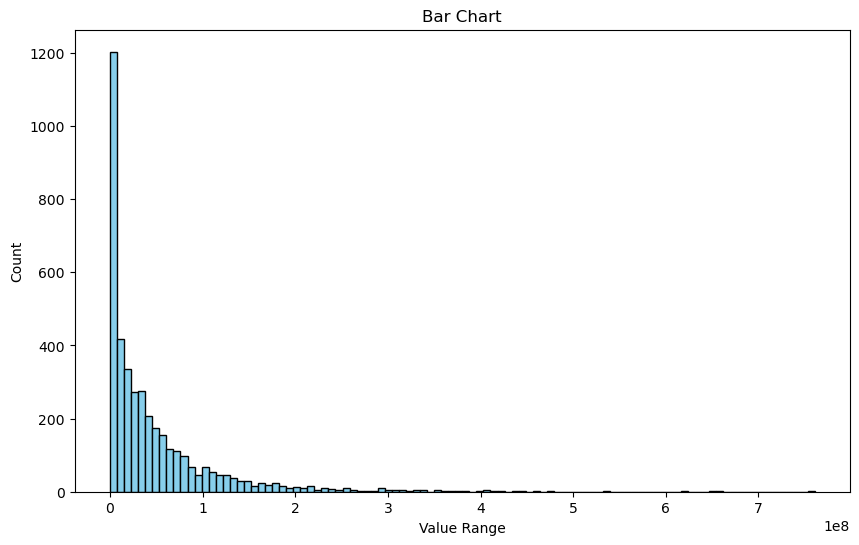

In [32]:
gross_column = data['gross'].dropna()
show_bar_chart(list(gross_column), 100)

In [33]:
data.loc[gross_column.idxmax()]

movie_title                                                            Avatar 
director_name                                                    James Cameron
num_critic_for_reviews                                                   723.0
duration                                                                 178.0
director_facebook_likes                                                    0.0
actor_3_facebook_likes                                                   855.0
actor_2_name                                                  Joel David Moore
actor_1_facebook_likes                                                  1000.0
gross                                                              760505847.0
genres                                         Action|Adventure|Fantasy|Sci-Fi
actor_1_name                                                       CCH Pounder
color                                                                    Color
num_voted_users                                     

In [34]:
if gross_column.idxmax() not in rows_to_delete:
    rows_to_delete.append(gross_column.idxmax())
    gross_column = gross_column.drop(index=gross_column.idxmax())

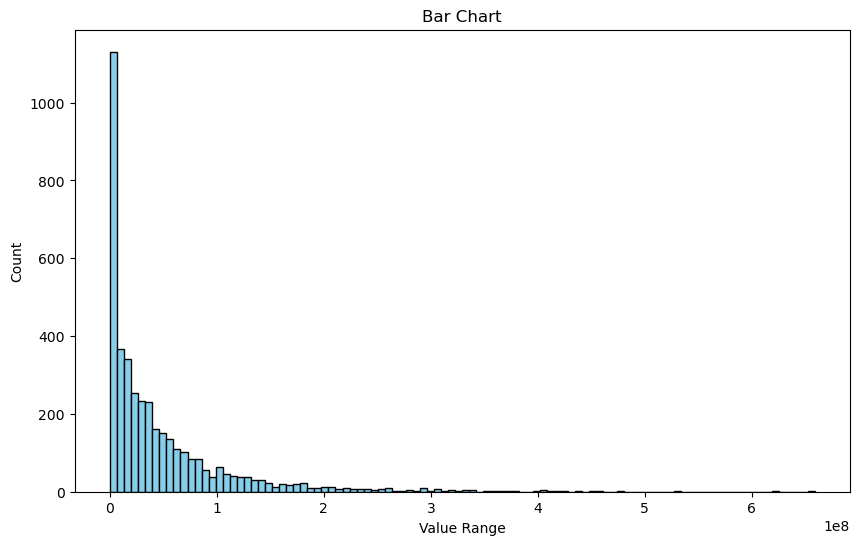

In [35]:
show_bar_chart(list(gross_column), 100)

In [36]:
data.loc[gross_column.idxmax()]

movie_title                                                           Titanic 
director_name                                                    James Cameron
num_critic_for_reviews                                                   315.0
duration                                                                 194.0
director_facebook_likes                                                    0.0
actor_3_facebook_likes                                                   794.0
actor_2_name                                                      Kate Winslet
actor_1_facebook_likes                                                 29000.0
gross                                                              658672302.0
genres                                                           Drama|Romance
actor_1_name                                                 Leonardo DiCaprio
color                                                                    Color
num_voted_users                                     

In [37]:
#Finding outliers 
gross_column = data['gross'].dropna()
Q1 = np.percentile(gross_column, 25)
Q3 = np.percentile(gross_column, 75)
IQR = Q3 - Q1
lower_bound = Q1 - 5 * IQR
upper_bound = Q3 + 5 * IQR
cnt = 0
for index in gross_column.index:
    if gross_column[index] < lower_bound or gross_column[index] > upper_bound:
        cnt += 1
        print(pd.DataFrame(data.loc[index]))
print(cnt)

                                                                           0
movie_title                                                          Avatar 
director_name                                                  James Cameron
num_critic_for_reviews                                                 723.0
duration                                                               178.0
director_facebook_likes                                                  0.0
actor_3_facebook_likes                                                 855.0
actor_2_name                                                Joel David Moore
actor_1_facebook_likes                                                1000.0
gross                                                            760505847.0
genres                                       Action|Adventure|Fantasy|Sci-Fi
actor_1_name                                                     CCH Pounder
color                                                                  Color

# Budget

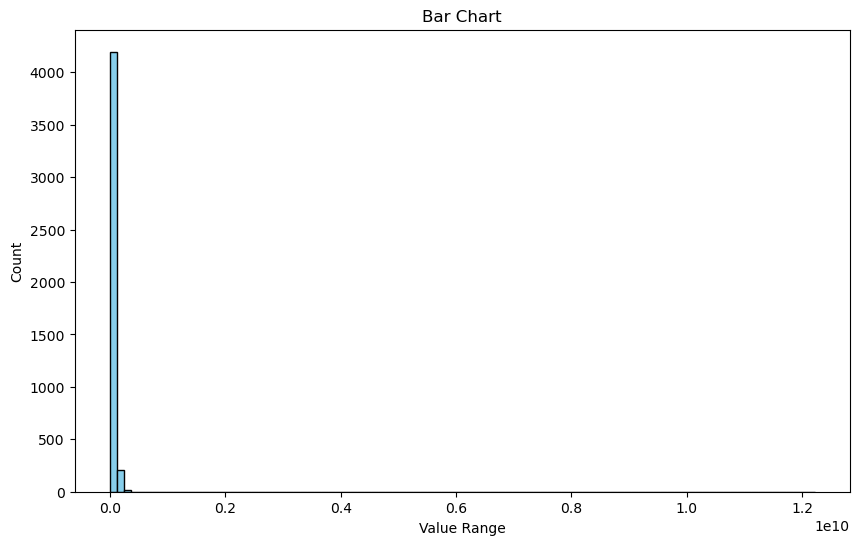

In [39]:
budget_column = data['budget'].drop(index=rows_to_delete)
show_bar_chart(list(budget_column.dropna()), 100)

In [40]:
print(rows_to_delete)

[0]


## Deleting errors from data

In [42]:
data.loc[budget_column.idxmax()]

movie_title                                                          The Host 
director_name                                                     Joon-ho Bong
num_critic_for_reviews                                                   363.0
duration                                                                 110.0
director_facebook_likes                                                  584.0
actor_3_facebook_likes                                                    74.0
actor_2_name                                                      Kang-ho Song
actor_1_facebook_likes                                                   629.0
gross                                                                2201412.0
genres                                              Comedy|Drama|Horror|Sci-Fi
actor_1_name                                                         Doona Bae
color                                                                    Color
num_voted_users                                     

In [43]:
budget_column.loc[budget_column.idxmax()] = None

In [44]:
data.loc[budget_column.idxmax()]

movie_title                                                    Lady Vengeance 
director_name                                                   Chan-wook Park
num_critic_for_reviews                                                   202.0
duration                                                                 112.0
director_facebook_likes                                                    0.0
actor_3_facebook_likes                                                    38.0
actor_2_name                                                      Yeong-ae Lee
actor_1_facebook_likes                                                   717.0
gross                                                                 211667.0
genres                                                             Crime|Drama
actor_1_name                                                      Min-sik Choi
color                                                                    Color
num_voted_users                                     

In [45]:
budget_column.loc[budget_column.idxmax()] = None

In [46]:
data.loc[budget_column.idxmax()]

movie_title                                                          Fateless 
director_name                                                     Lajos Koltai
num_critic_for_reviews                                                    73.0
duration                                                                 134.0
director_facebook_likes                                                   45.0
actor_3_facebook_likes                                                     0.0
actor_2_name                                                   Péter Fancsikai
actor_1_facebook_likes                                                     9.0
gross                                                                 195888.0
genres                                                       Drama|Romance|War
actor_1_name                                                      Marcell Nagy
color                                                                    Color
num_voted_users                                     

In [47]:
budget_column.loc[budget_column.idxmax()] = None

In [48]:
data.loc[budget_column.idxmax()]

movie_title                                                 Princess Mononoke 
director_name                                                   Hayao Miyazaki
num_critic_for_reviews                                                   174.0
duration                                                                 134.0
director_facebook_likes                                                 6000.0
actor_3_facebook_likes                                                   745.0
actor_2_name                                                Jada Pinkett Smith
actor_1_facebook_likes                                                   893.0
gross                                                                2298191.0
genres                                             Adventure|Animation|Fantasy
actor_1_name                                                     Minnie Driver
color                                                                    Color
num_voted_users                                     

In [49]:
budget_column.loc[budget_column.idxmax()] = None

In [50]:
data.loc[budget_column.idxmax()]

movie_title                                                          Steamboy 
director_name                                                  Katsuhiro Ôtomo
num_critic_for_reviews                                                   105.0
duration                                                                 103.0
director_facebook_likes                                                   78.0
actor_3_facebook_likes                                                   101.0
actor_2_name                                                Robin Atkin Downes
actor_1_facebook_likes                                                   488.0
gross                                                                 410388.0
genres                       Action|Adventure|Animation|Family|Sci-Fi|Thriller
actor_1_name                                                  William Hootkins
color                                                                    Color
num_voted_users                                     

In [51]:
budget_column.loc[budget_column.idxmax()] = None

In [52]:
data.loc[budget_column.idxmax()]

movie_title                                                             Akira 
director_name                                                  Katsuhiro Ôtomo
num_critic_for_reviews                                                   150.0
duration                                                                 124.0
director_facebook_likes                                                   78.0
actor_3_facebook_likes                                                     4.0
actor_2_name                                                     Takeshi Kusao
actor_1_facebook_likes                                                     6.0
gross                                                                 439162.0
genres                                                 Action|Animation|Sci-Fi
actor_1_name                                                      Mitsuo Iwata
color                                                                    Color
num_voted_users                                     

In [53]:
budget_column.loc[budget_column.idxmax()] = None

In [54]:
data.loc[budget_column.idxmax()]

movie_title                                                     Godzilla 2000 
director_name                                                    Takao Okawara
num_critic_for_reviews                                                   107.0
duration                                                                  99.0
director_facebook_likes                                                    2.0
actor_3_facebook_likes                                                     3.0
actor_2_name                                                     Naomi Nishida
actor_1_facebook_likes                                                    43.0
gross                                                               10037390.0
genres                                  Action|Adventure|Drama|Sci-Fi|Thriller
actor_1_name                                                       Hiroshi Abe
color                                                                    Color
num_voted_users                                     

In [55]:
budget_column.loc[budget_column.idxmax()] = None

In [56]:
data.loc[budget_column.idxmax()]

movie_title                                            Kabhi Alvida Naa Kehna 
director_name                                                      Karan Johar
num_critic_for_reviews                                                    20.0
duration                                                                 193.0
director_facebook_likes                                                  160.0
actor_3_facebook_likes                                                   860.0
actor_2_name                                                      John Abraham
actor_1_facebook_likes                                                  8000.0
gross                                                                3275443.0
genres                                                                   Drama
actor_1_name                                                    Shah Rukh Khan
color                                                                    Color
num_voted_users                                     

In [57]:
budget_column.loc[budget_column.idxmax()] = None

In [58]:
data.loc[budget_column.idxmax()]

movie_title                                                             Tango 
director_name                                                     Carlos Saura
num_critic_for_reviews                                                    35.0
duration                                                                 115.0
director_facebook_likes                                                   98.0
actor_3_facebook_likes                                                     4.0
actor_2_name                                                Juan Luis Galiardo
actor_1_facebook_likes                                                   341.0
gross                                                                1687311.0
genres                                                           Drama|Musical
actor_1_name                                                       Mía Maestro
color                                                                    Color
num_voted_users                                     

In [59]:
budget_column.loc[budget_column.idxmax()] = None

In [60]:
data.loc[budget_column.idxmax()]

movie_title                                                             Kites 
director_name                                                      Anurag Basu
num_critic_for_reviews                                                    41.0
duration                                                                  90.0
director_facebook_likes                                                  116.0
actor_3_facebook_likes                                                   303.0
actor_2_name                                            Steven Michael Quezada
actor_1_facebook_likes                                                   594.0
gross                                                                1602466.0
genres                                           Action|Drama|Romance|Thriller
actor_1_name                                                      Bárbara Mori
color                                                                    Color
num_voted_users                                     

In [61]:
budget_column.loc[budget_column.idxmax()] = None

In [62]:
data.loc[budget_column.idxmax()]

movie_title                                                         Red Cliff 
director_name                                                         John Woo
num_critic_for_reviews                                                   160.0
duration                                                                 150.0
director_facebook_likes                                                  610.0
actor_3_facebook_likes                                                   478.0
actor_2_name                                               Tony Chiu Wai Leung
actor_1_facebook_likes                                                   755.0
gross                                                                 626809.0
genres                                      Action|Adventure|Drama|History|War
actor_1_name                                                 Takeshi Kaneshiro
color                                                                    Color
num_voted_users                                     

In [63]:
budget_column.loc[budget_column.idxmax()] = None

In [64]:
data.loc[budget_column.idxmax()]

movie_title                                          The Legend of Suriyothai 
director_name                                              Chatrichalerm Yukol
num_critic_for_reviews                                                    31.0
duration                                                                 300.0
director_facebook_likes                                                    6.0
actor_3_facebook_likes                                                     6.0
actor_2_name                                              Chatchai Plengpanich
actor_1_facebook_likes                                                     7.0
gross                                                                 454255.0
genres                                      Action|Adventure|Drama|History|War
actor_1_name                                              Sarunyu Wongkrachang
color                                                                    Color
num_voted_users                                     

In [65]:
budget_column.loc[budget_column.idxmax()] = None

In [66]:
data.loc[budget_column.idxmax()]

movie_title                           The Messenger: The Story of Joan of Arc 
director_name                                                       Luc Besson
num_critic_for_reviews                                                   111.0
duration                                                                 158.0
director_facebook_likes                                                    0.0
actor_3_facebook_likes                                                    15.0
actor_2_name                                                      David Bailie
actor_1_facebook_likes                                                    51.0
gross                                                               14131298.0
genres                                   Adventure|Biography|Drama|History|War
actor_1_name                                                       Paul Brooke
color                                                                    Color
num_voted_users                                     

In [67]:
budget_column.loc[budget_column.idxmax()] = None

In [68]:
data.loc[budget_column.idxmax()]

movie_title                          Pirates of the Caribbean: At World's End 
director_name                                                   Gore Verbinski
num_critic_for_reviews                                                   302.0
duration                                                                 169.0
director_facebook_likes                                                  563.0
actor_3_facebook_likes                                                  1000.0
actor_2_name                                                     Orlando Bloom
actor_1_facebook_likes                                                 40000.0
gross                                                              309404152.0
genres                                                Action|Adventure|Fantasy
actor_1_name                                                       Johnny Depp
color                                                                    Color
num_voted_users                                     

## Trying models

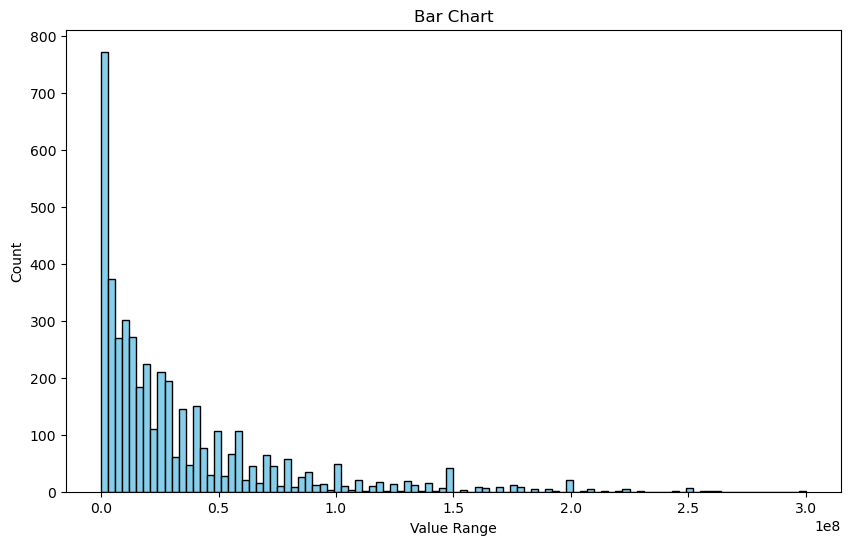

In [70]:
show_bar_chart(list(budget_column.dropna()), 100)

In [71]:
#Finding outliers 
Q1 = np.percentile(budget_column.dropna().sort_values(), 25)
Q3 = np.percentile(budget_column.dropna().sort_values(), 75)
IQR = Q3 - Q1
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR
cnt = 0
for index in budget_column.dropna().sort_values().index:
    if budget_column[index] < lower_bound or budget_column[index] > upper_bound:
        cnt += 1
        print(pd.DataFrame(data.loc[index]))
print(cnt)

                                                                         350
movie_title                                                Cutthroat Island 
director_name                                                   Renny Harlin
num_critic_for_reviews                                                  61.0
duration                                                               124.0
director_facebook_likes                                                212.0
actor_3_facebook_likes                                                 810.0
actor_2_name                                                  Frank Langella
actor_1_facebook_likes                                                1000.0
gross                                                             11000000.0
genres                                               Action|Adventure|Comedy
actor_1_name                                           Christopher Masterson
color                                                                  Color

In [72]:
budget_column.loc[[1]] = None

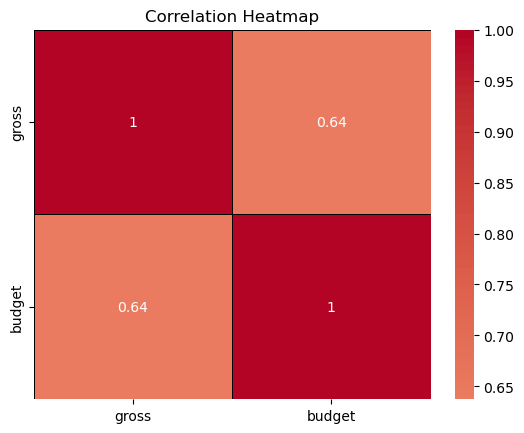

In [73]:
indexes = []
for index in gross_column.index:
    if index in budget_column.index:
        indexes.append(index)
t = pd.concat([gross_column.loc[indexes], budget_column.loc[indexes]], axis=1)
correlation_matrix = t.corr()
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', center=0, linewidths=0.5, linecolor='black')

plt.title('Correlation Heatmap')
plt.show()

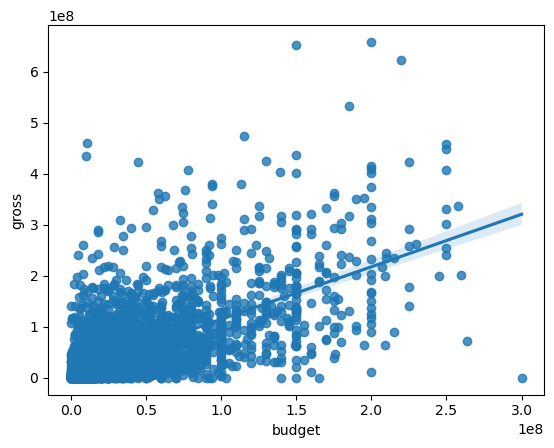

In [74]:
indexes = []
for index in gross_column.index:
    if index in budget_column.index:
        indexes.append(index)
t = pd.concat([gross_column.loc[indexes], budget_column.loc[indexes]], axis=1)
sns.regplot(data=t, x='budget', y='gross')
plt.show()

In [75]:
indexes = []
for index in gross_column.index:
    if index in budget_column.index:
        indexes.append(index)
t = pd.concat([gross_column.loc[indexes], budget_column.loc[indexes]], axis=1)
t = t.dropna()
y = t['gross'].to_frame()
X = t['budget'].to_frame()
X_train_val, X_test, y_train_val, y_test = train_test_split(X, y, test_size=0.2, random_state=2)
res = runCrossValidationSGDRegressor(X_train_val, y_train_val)
res.sort_values(by='mean_test_mse')

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_alpha,param_eta0,param_loss,params,split0_test_mae,split1_test_mae,split2_test_mae,split3_test_mae,split4_test_mae,mean_test_mae,std_test_mae,rank_test_mae,split0_train_mae,split1_train_mae,split2_train_mae,split3_train_mae,split4_train_mae,mean_train_mae,std_train_mae,split0_test_mse,split1_test_mse,split2_test_mse,split3_test_mse,split4_test_mse,mean_test_mse,std_test_mse,rank_test_mse,split0_train_mse,split1_train_mse,split2_train_mse,split3_train_mse,split4_train_mse,mean_train_mse,std_train_mse,split0_test_mape,split1_test_mape,split2_test_mape,split3_test_mape,split4_test_mape,mean_test_mape,std_test_mape,rank_test_mape,split0_train_mape,split1_train_mape,split2_train_mape,split3_train_mape,split4_train_mape,mean_train_mape,std_train_mape,split0_test_r2,split1_test_r2,split2_test_r2,split3_test_r2,split4_test_r2,mean_test_r2,std_test_r2,rank_test_r2,split0_train_r2,split1_train_r2,split2_train_r2,split3_train_r2,split4_train_r2,mean_train_r2,std_train_r2
2,0.005254,0.000972,0.001180,0.000063,0,0.01,squared_error,"{'alpha': 0, 'eta0': 0.01, 'loss': 'squared_er...",0.043379,0.052321,0.050026,0.049484,0.047934,0.048629,0.002979,38,0.048625,0.048924,0.049616,0.048349,0.047145,0.048532,0.000812,0.005107,0.006515,0.006443,0.007303,0.007073,0.006488,0.000764,40,0.006819,0.006413,0.006429,0.006226,0.006374,0.006452,0.000197,67.387575,48.854071,94.816123,1.312951e+11,773.299072,2.625902e+10,5.251803e+10,33,2.298666e+10,4.045482e+10,3.599370e+10,333.067397,2.309835e+10,2.450671e+10,1.407953e+10,0.406776,0.425042,0.338980,0.435493,0.343578,0.389974,0.040834,1,0.391478,0.390433,0.411448,0.385178,0.402451,0.396197,0.009472
0,0.021895,0.002920,0.001318,0.000095,0,0.001,squared_error,"{'alpha': 0, 'eta0': 0.001, 'loss': 'squared_e...",0.045327,0.053205,0.050109,0.051433,0.051857,0.050386,0.002716,33,0.050918,0.049536,0.050057,0.050301,0.050842,0.050331,0.000513,0.005032,0.006655,0.006339,0.007441,0.007079,0.006509,0.000828,39,0.006847,0.006453,0.006471,0.006258,0.006420,0.006490,0.000194,128.125617,56.669885,106.867294,2.030102e+11,1904.378346,4.060204e+10,8.120409e+10,27,4.585164e+10,4.920373e+10,4.472267e+10,511.749827,5.569494e+10,3.909460e+10,1.991726e+10,0.415557,0.412730,0.349649,0.424784,0.343079,0.389160,0.035230,2,0.388927,0.386637,0.407591,0.381988,0.398153,0.392659,0.009135
8,0.033088,0.005719,0.001661,0.000202,0.001,0.001,squared_error,"{'alpha': 0.001, 'eta0': 0.001, 'loss': 'squar...",0.046075,0.053102,0.051132,0.052090,0.051265,0.050733,0.002433,32,0.051619,0.049425,0.051258,0.050932,0.050273,0.050701,0.000777,0.005036,0.006668,0.006341,0.007533,0.007048,0.006525,0.000844,38,0.006844,0.006458,0.006534,0.006300,0.006385,0.006504,0.000187,139.309096,56.232831,121.595525,2.247433e+11,1753.544078,4.494865e+10,8.989731e+10,24,5.001087e+10,4.881099e+10,5.429107e+10,565.850344,5.135303e+10,4.089319e+10,2.052797e+10,0.415067,0.411559,0.349410,0.417684,0.345917,0.387927,0.032951,3,0.389269,0.386205,0.401884,0.377818,0.401438,0.391323,0.009238
3,0.008643,0.002013,0.001169,0.000030,0,0.01,huber,"{'alpha': 0, 'eta0': 0.01, 'loss': 'huber'}",0.042687,0.050676,0.047642,0.048994,0.049795,0.047959,0.002818,39,0.048115,0.046980,0.047785,0.047756,0.048835,0.047894,0.000600,0.005169,0.006828,0.006330,0.007508,0.007038,0.006575,0.000798,37,0.007023,0.006556,0.006549,0.006309,0.006359,0.006559,0.000252,69.185074,39.515410,80.076863,1.340697e+11,1386.342716,2.681395e+10,5.362790e+10,31,2.391083e+10,3.191164e+10,2.919881e+10,339.519782,4.076324e+10,2.515690e+10,1.371090e+10,0.399584,0.397469,0.350541,0.419603,0.346841,0.382807,0.028931,4,0.373218,0.376853,0.400512,0.377006,0.403799,0.386277,0.013076
10,0.006897,0.001525,0.001458,0.000104,0.001,0.01,squared_error,"{'alpha': 0.001, 'eta0': 0.01, 'loss': 'square...",0.045156,0.050315,0.055956,0.048625,0.048566,0.049724,0.003539,34,0.050683,0.046643,0.055550,0.047420,0.047714,0.049602,0.003275,0.005036,0.006742,0.006698,0.007523,0.00

In [76]:
indexes = []
for index in gross_column.index:
    if index in budget_column.index:
        indexes.append(index)
t = pd.concat([gross_column.loc[indexes], budget_column.loc[indexes]], axis=1)
t = t.dropna()
y = t['gross'].to_frame()
X = t['budget'].to_frame()
X_train_val, X_test, y_train_val, y_test = train_test_split(X, y, test_size=0.2, random_state=2)
res = runCrossValidationSGDRegressor(make_polynomial(X_train_val), y_train_val)
res.sort_values(by='mean_test_mse')

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_alpha,param_eta0,param_loss,params,split0_test_mae,split1_test_mae,split2_test_mae,split3_test_mae,split4_test_mae,mean_test_mae,std_test_mae,rank_test_mae,split0_train_mae,split1_train_mae,split2_train_mae,split3_train_mae,split4_train_mae,mean_train_mae,std_train_mae,split0_test_mse,split1_test_mse,split2_test_mse,split3_test_mse,split4_test_mse,mean_test_mse,std_test_mse,rank_test_mse,split0_train_mse,split1_train_mse,split2_train_mse,split3_train_mse,split4_train_mse,mean_train_mse,std_train_mse,split0_test_mape,split1_test_mape,split2_test_mape,split3_test_mape,split4_test_mape,mean_test_mape,std_test_mape,rank_test_mape,split0_train_mape,split1_train_mape,split2_train_mape,split3_train_mape,split4_train_mape,mean_train_mape,std_train_mape,split0_test_r2,split1_test_r2,split2_test_r2,split3_test_r2,split4_test_r2,mean_test_r2,std_test_r2,rank_test_r2,split0_train_r2,split1_train_r2,split2_train_r2,split3_train_r2,split4_train_r2,mean_train_r2,std_train_r2
2,0.007241,0.001968,0.001544,0.000006,0,0.01,squared_error,"{'alpha': 0, 'eta0': 0.01, 'loss': 'squared_er...",0.045393,0.050345,0.047486,0.050524,0.049137,0.048577,0.001926,37,0.050218,0.047419,0.046734,0.049572,0.048445,0.048478,0.001295,0.005180,0.006577,0.006720,0.007193,0.006963,0.006526,0.000705,40,0.006764,0.006487,0.006582,0.006258,0.006339,0.006486,0.000179,119.827441,43.967673,67.512941,1.911325e+11,1367.027641,3.822651e+10,7.645301e+10,28,4.284891e+10,3.686355e+10,2.101184e+10,483.182160,4.010872e+10,2.816660e+10,1.598980e+10,0.398325,0.419648,0.310605,0.444022,0.353798,0.385279,0.047685,1,0.396385,0.383408,0.397434,0.382000,0.405712,0.392988,0.009008
8,0.016322,0.000886,0.001194,0.000131,0.001,0.001,squared_error,"{'alpha': 0.001, 'eta0': 0.001, 'loss': 'squar...",0.047428,0.054171,0.051143,0.052525,0.051871,0.051428,0.002236,30,0.052297,0.051042,0.050830,0.051509,0.051042,0.051344,0.000526,0.005152,0.006686,0.006479,0.007459,0.007035,0.006562,0.000780,39,0.006826,0.006521,0.006492,0.006348,0.006416,0.006521,0.000164,169.260628,71.133991,128.732066,2.629867e+11,2150.288797,5.259734e+10,1.051947e+11,24,6.147543e+10,6.553553e+10,5.913561e+10,661.822666,6.265198e+10,4.975971e+10,2.496510e+10,0.401622,0.410010,0.335245,0.423400,0.347165,0.383488,0.035418,2,0.390803,0.380228,0.405736,0.373111,0.398511,0.389678,0.011840
3,0.008929,0.001705,0.001379,0.000184,0,0.01,huber,"{'alpha': 0, 'eta0': 0.01, 'loss': 'huber'}",0.043550,0.051667,0.048396,0.048321,0.048317,0.048050,0.002592,40,0.048612,0.048500,0.048008,0.047290,0.047461,0.047974,0.000532,0.005200,0.006691,0.006488,0.007453,0.007099,0.006586,0.000769,38,0.006911,0.006500,0.006509,0.006391,0.006445,0.006551,0.000185,97.753868,54.306024,94.049737,1.356693e+11,1201.129555,2.713385e+10,5.426771e+10,33,3.479171e+10,4.795989e+10,3.801760e+10,344.057834,3.526337e+10,3.120651e+10,1.631088e+10,0.396068,0.409542,0.334391,0.423881,0.341227,0.381022,0.036427,4,0.383212,0.382226,0.404188,0.368856,0.395799,0.386856,0.012158
0,0.018910,0.003701,0.001536,0.000125,0,0.001,squared_error,"{'alpha': 0, 'eta0': 0.001, 'loss': 'squared_e...",0.046968,0.053146,0.052040,0.052928,0.052129,0.051442,0.002279,29,0.051790,0.050146,0.051710,0.051869,0.051221,0.051347,0.000642,0.005152,0.006595,0.006514,0.007594,0.007083,0.006587,0.000815,37,0.006791,0.006477,0.006497,0.006423,0.006459,0.006529,0.000133,156.516157,64.745211,137.059421,2.790398e+11,2233.725380,5.580796e+10,1.116159e+11,23,5.665221e+10,5.868516e+10,6.396903e+10,701.680557,6.504069e+10,4.886942e+10,2.463594e+10,0.401584,0.417999,0.331729,0.413005,0.342732,0.381410,0.036628,3,0.393953,0.384370,0.405240,0.365708,0.394484,0.388751,0.013282
11,0.005042,0.000497,0.001089,0.000003,0.001,0.01,huber,"{'alpha': 0.001, 'eta0': 0.01, 'loss': 'huber'}",0.045574,0.050987,0.050580,0.049649,0.049253,0.049209,0.001921,34,0.050743,0.047788,0.050315,0.048533,0.048267,0.049129,0.001176,0.005133,0.006881,0.006453,0.007469,0.007121,0.0

In [77]:
indexes = []
for index in gross_column.index:
    if index in budget_column.index:
        indexes.append(index)
t = pd.concat([gross_column.loc[indexes], budget_column.loc[indexes]], axis=1)
t = t.dropna()
y = t['gross'].to_frame()
X = t['budget'].to_frame()
X_train_val, X_test, y_train_val, y_test = train_test_split(X, y, test_size=0.2, random_state=2)
res = runCrossValidationRandomForestRegressor(X_train_val, y_train_val)
res.sort_values(by='mean_test_mse')

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_max_depth,param_min_samples_leaf,param_min_samples_split,param_n_estimators,params,split0_test_mae,split1_test_mae,split2_test_mae,split3_test_mae,split4_test_mae,mean_test_mae,std_test_mae,rank_test_mae,split0_train_mae,split1_train_mae,split2_train_mae,split3_train_mae,split4_train_mae,mean_train_mae,std_train_mae,split0_test_mse,split1_test_mse,split2_test_mse,split3_test_mse,split4_test_mse,mean_test_mse,std_test_mse,rank_test_mse,split0_train_mse,split1_train_mse,split2_train_mse,split3_train_mse,split4_train_mse,mean_train_mse,std_train_mse,split0_test_mape,split1_test_mape,split2_test_mape,split3_test_mape,split4_test_mape,mean_test_mape,std_test_mape,rank_test_mape,split0_train_mape,split1_train_mape,split2_train_mape,split3_train_mape,split4_train_mape,mean_train_mape,std_train_mape,split0_test_r2,split1_test_r2,split2_test_r2,split3_test_r2,split4_test_r2,mean_test_r2,std_test_r2,rank_test_r2,split0_train_r2,split1_train_r2,split2_train_r2,split3_train_r2,split4_train_r2,mean_train_r2,std_train_r2
22,0.116491,0.002417,0.007140,0.000251,5,20,5,100,"{'max_depth': 5, 'min_samples_leaf': 20, 'min_...",0.044940,0.051239,0.050151,0.050212,0.051381,0.049585,0.002377,81,0.049361,0.047923,0.048462,0.047910,0.047699,0.048271,0.000600,0.005157,0.006392,0.006375,0.007281,0.007414,0.006524,0.000809,81,0.006430,0.006127,0.006125,0.005919,0.005930,0.006106,0.000185,78.013792,36.202121,73.221554,6.949197e+10,503.763219,1.389839e+10,2.779679e+10,3,1.579582e+10,1.591617e+10,1.895971e+10,203.185586,1.110108e+10,1.235456e+10,6.668758e+09,0.401027,0.435957,0.345924,0.437207,0.311994,0.386422,0.049851,1,0.426206,0.417601,0.439290,0.415513,0.444068,0.428536,0.011415
23,1.084168,0.014235,0.054637,0.001182,5,20,5,1000,"{'max_depth': 5, 'min_samples_leaf': 20, 'min_...",0.045037,0.051359,0.050249,0.050280,0.051364,0.049658,0.002362,80,0.049355,0.047906,0.048404,0.047938,0.047624,0.048245,0.000609,0.005165,0.006434,0.006401,0.007278,0.007413,0.006538,0.000803,80,0.006427,0.006124,0.006126,0.005917,0.005926,0.006104,0.000185,78.271136,36.713344,72.511396,6.730597e+10,495.759703,1.346119e+10,2.692239e+10,7,1.560199e+10,1.428762e+10,1.836692e+10,211.930215,1.122395e+10,1.189609e+10,6.376418e+09,0.400097,0.432241,0.343333,0.437412,0.312107,0.385038,0.049510,2,0.426464,0.417901,0.439203,0.415700,0.444427,0.428739,0.011387
20,1.099663,0.045242,0.055249,0.003415,5,20,2,1000,"{'max_depth': 5, 'min_samples_leaf': 20, 'min_...",0.045016,0.051399,0.050246,0.050256,0.051433,0.049670,0.002385,78,0.049347,0.047899,0.048374,0.047944,0.047660,0.048245,0.000597,0.005167,0.006433,0.006406,0.007273,0.007425,0.006541,0.000804,79,0.006426,0.006124,0.006125,0.005916,0.005927,0.006104,0.000185,78.700123,36.522545,72.198995,6.746053e+10,499.089137,1.349211e+10,2.698421e+10,6,1.543541e+10,1.439715e+10,1.799691e+10,207.830508,1.124748e+10,1.181539e+10,6.291378e+09,0.399823,0.432286,0.342791,0.437809,0.310928,0.384727,0.050025,4,0.426523,0.417914,0.439346,0.415742,0.444385,0.428782,0.011387
25,0.106955,0.001945,0.007218,0.001490,5,20,20,100,"{'max_depth': 5, 'min_samples_leaf': 20, 'min_...",0.045163,0.051288,0.050296,0.050241,0.051553,0.049708,0.002332,75,0.049477,0.047877,0.048353,0.048016,0.047682,0.048281,0.000637,0.005165,0.006420,0.006421,0.007253,0.007445,0.006541,0.000806,78,0.006427,0.006124,0.006126,0.005916,0.005928,0.006104,0.000185,78.054175,36.240061,71.288721,6.424207e+10,505.117907,1.284841e+10,2.569683e+10,19,1.430283e+10,1.452717e+10,1.747028e+10,204.058639,1.098180e+10,1.145642e+10,6.085604e+09,0.400100,0.433421,0.341228,0.439357,0.309062,0.384633,0.051399,6,0.426470,0.417902,0.439173,0.415808,0.444254,0.428721,0.011308
19,0.106742,0.002001,0.006529,0.000184,5,20,2,100,"{'max_depth': 5, 'min_samples_leaf': 20, 'min_...",0.045042,0.051334,0.050245,0.050311,0.051603,0.049707,0.002394,76,0.049358,0.047865,0.048429,0.047962,0.047713,0.048265,0.000596,0.005147,0.006441,0.006405,0.007259,0.007

In [78]:
indexes = []
for index in gross_column.index:
    if index in budget_column.index:
        indexes.append(index)
t = pd.concat([gross_column.loc[indexes], budget_column.loc[indexes]], axis=1)
t = t.dropna()
y = t['gross'].to_frame()
X = t['budget'].to_frame()
X_train_val, X_test, y_train_val, y_test = train_test_split(X, y, test_size=0.2, random_state=2)
res = runCrossValidationGradientBoostingRegressor(X_train_val, y_train_val)
res.sort_values(by='mean_test_mse')

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_learning_rate,param_n_estimators,params,split0_test_mae,split1_test_mae,split2_test_mae,split3_test_mae,split4_test_mae,mean_test_mae,std_test_mae,rank_test_mae,split0_train_mae,split1_train_mae,split2_train_mae,split3_train_mae,split4_train_mae,mean_train_mae,std_train_mae,split0_test_mse,split1_test_mse,split2_test_mse,split3_test_mse,split4_test_mse,mean_test_mse,std_test_mse,rank_test_mse,split0_train_mse,split1_train_mse,split2_train_mse,split3_train_mse,split4_train_mse,mean_train_mse,std_train_mse,split0_test_mape,split1_test_mape,split2_test_mape,split3_test_mape,split4_test_mape,mean_test_mape,std_test_mape,rank_test_mape,split0_train_mape,split1_train_mape,split2_train_mape,split3_train_mape,split4_train_mape,mean_train_mape,std_train_mape,split0_test_r2,split1_test_r2,split2_test_r2,split3_test_r2,split4_test_r2,mean_test_r2,std_test_r2,rank_test_r2,split0_train_r2,split1_train_r2,split2_train_r2,split3_train_r2,split4_train_r2,mean_train_r2,std_train_r2
7,0.207203,0.006851,0.003571,0.000223,0.01,300,"{'learning_rate': 0.01, 'n_estimators': 300}",0.045313,0.052333,0.050671,0.050443,0.051243,0.050001,0.002433,16,0.049650,0.047754,0.048507,0.048221,0.047857,0.048398,0.000681,0.005138,0.006548,0.006337,0.007177,0.007273,0.006495,0.000767,16,0.006228,0.005864,0.005884,0.005780,0.005757,0.005902,0.000170,99.484705,44.623328,103.336071,1.072405e+11,839.475937,2.144809e+10,4.289619e+10,5,2.939993e+10,2.638977e+10,2.962474e+10,298.241344,2.308356e+10,2.169960e+10,1.110755e+10,0.403261,0.422131,0.349892,0.445210,0.325078,0.389114,0.044891,1,0.444218,0.442613,0.461397,0.429241,0.460274,0.447549,0.012036
6,0.136281,0.002788,0.002789,0.000064,0.01,200,"{'learning_rate': 0.01, 'n_estimators': 200}",0.046108,0.053285,0.050980,0.051563,0.051760,0.050739,0.002438,13,0.050689,0.048837,0.049603,0.049229,0.048931,0.049458,0.000671,0.005103,0.006699,0.006270,0.007377,0.007247,0.006539,0.000820,15,0.006408,0.006055,0.006088,0.005956,0.005944,0.006090,0.000168,128.881655,52.889626,112.543777,1.497531e+11,1195.726590,2.995061e+10,5.990122e+10,4,4.161754e+10,3.730350e+10,4.074504e+10,400.379070,3.349848e+10,3.063291e+10,1.558205e+10,0.407234,0.408880,0.356717,0.429765,0.327430,0.386005,0.037889,2,0.428177,0.424505,0.442722,0.411777,0.442748,0.429986,0.011747
12,0.007325,0.000071,0.001296,0.000006,0.5,10,"{'learning_rate': 0.5, 'n_estimators': 10}",0.045301,0.052380,0.051042,0.050124,0.052117,0.050193,0.002574,15,0.048992,0.047009,0.047527,0.047494,0.046967,0.047598,0.000735,0.005292,0.006584,0.006566,0.007145,0.007712,0.006660,0.000803,14,0.006076,0.005718,0.005647,0.005631,0.005552,0.005725,0.000183,73.799751,38.802930,99.612582,9.313024e+10,598.525563,1.862605e+10,3.725209e+10,6,2.079816e+10,1.883551e+10,2.309120e+10,256.716927,1.213298e+10,1.497157e+10,8.330822e+09,0.385309,0.418991,0.326373,0.447715,0.284325,0.372543,0.059809,3,0.457730,0.456549,0.483040,0.443887,0.479492,0.464139,0.014845
1,0.084448,0.006949,0.002181,0.000266,0.1,100,"{'learning_rate': 0.1, 'n_estimators': 100}",0.045476,0.052106,0.050962,0.049937,0.052506,0.050197,0.002527,14,0.048206,0.046180,0.046930,0.046696,0.046186,0.046839,0.000743,0.005407,0.006622,0.006665,0.007055,0.007726,0.006695,0.000756,13,0.005868,0.005430,0.005464,0.005452,0.005346,0.005512,0.000183,67.206449,37.655361,102.805056,7.320558e+10,519.595582,1.464112e+10,2.928223e+10,8,1.755644e+10,1.691966e+10,1.998384e+10,218.712130,1.045216e+10,1.298242e+10,7.216493e+09,0.371978,0.415613,0.316196,0.454642,0.283050,0.368296,0.062753,4,0.476316,0.483863,0.499813,0.461551,0.498850,0.484079,0.014377
2,0.139183,0.003107,0.002328,0.000084,0.1,200,"{'learning_rate': 0.1, 'n_estimators': 200}",0.046046,0.052536,0.051552,0.049892,0.053794,0.050764,0.002682,12,0.047451,0.045466,0.045897,0.045992,0.045311,0.046023,0.000758,0.005620,0.006823,0.007003,0.007015,0.008035,0.006899,0.000769,12,0.005659,0.005241,0.005184,0.005269,0.005136,0.005298,0.000186,5

In [79]:
indexes = []
for index in gross_column.index:
    if index in budget_column.index:
        indexes.append(index)
t = pd.concat([gross_column.loc[indexes], budget_column.loc[indexes]], axis=1)
t = t.dropna()
y = t['gross'].to_frame()
X = t['budget'].to_frame()
X_train_val, X_test, y_train_val, y_test = train_test_split(X, y, test_size=0.2, random_state=2)
res = runCrossValidationXGBRegressor(X_train_val, y_train_val)
res.sort_values(by='mean_test_mse')

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_learning_rate,param_n_estimators,params,split0_test_mae,split1_test_mae,split2_test_mae,split3_test_mae,split4_test_mae,mean_test_mae,std_test_mae,rank_test_mae,split0_train_mae,split1_train_mae,split2_train_mae,split3_train_mae,split4_train_mae,mean_train_mae,std_train_mae,split0_test_mse,split1_test_mse,split2_test_mse,split3_test_mse,split4_test_mse,mean_test_mse,std_test_mse,rank_test_mse,split0_train_mse,split1_train_mse,split2_train_mse,split3_train_mse,split4_train_mse,mean_train_mse,std_train_mse,split0_test_mape,split1_test_mape,split2_test_mape,split3_test_mape,split4_test_mape,mean_test_mape,std_test_mape,rank_test_mape,split0_train_mape,split1_train_mape,split2_train_mape,split3_train_mape,split4_train_mape,mean_train_mape,std_train_mape,split0_test_r2,split1_test_r2,split2_test_r2,split3_test_r2,split4_test_r2,mean_test_r2,std_test_r2,rank_test_r2,split0_train_r2,split1_train_r2,split2_train_r2,split3_train_r2,split4_train_r2,mean_train_r2,std_train_r2
7,0.089281,0.001203,0.002594,0.000022,0.01,300,"{'learning_rate': 0.01, 'n_estimators': 300}",0.045816,0.052499,0.051221,0.050593,0.052493,0.050524,0.002467,15,0.049422,0.047928,0.048501,0.048035,0.047473,0.048272,0.000662,0.005333,0.006727,0.006488,0.007137,0.007360,0.006609,0.000707,16,0.006172,0.005929,0.005875,0.005713,0.005738,0.005885,0.000165,85.574100,42.933515,91.707528,8.655353e+10,701.923014,1.731071e+10,3.462141e+10,5,1.943353e+10,1.990959e+10,2.017519e+10,249.559077,1.354645e+10,1.461295e+10,7.705928e+09,0.380581,0.406395,0.334322,0.448336,0.316959,0.377319,0.047732,1,0.449227,0.436476,0.462187,0.435851,0.462026,0.449154,0.011604
6,0.062560,0.001682,0.002356,0.000046,0.01,200,"{'learning_rate': 0.01, 'n_estimators': 200}",0.046377,0.053398,0.051414,0.051480,0.052875,0.051108,0.002489,4,0.050250,0.048755,0.049302,0.048870,0.048394,0.049114,0.000638,0.005255,0.006858,0.006362,0.007293,0.007382,0.006630,0.000777,15,0.006278,0.006034,0.005998,0.005815,0.005847,0.005994,0.000165,114.152942,51.728835,105.042929,1.284153e+11,1045.989711,2.568305e+10,5.136610e+10,4,3.103037e+10,3.036875e+10,3.160593e+10,347.422874,2.596547e+10,2.379410e+10,1.206224e+10,0.389692,0.394826,0.347311,0.436271,0.314909,0.376602,0.041780,2,0.439747,0.426474,0.450962,0.425779,0.451855,0.438963,0.011319
12,0.004916,0.000066,0.001875,0.000004,0.5,10,"{'learning_rate': 0.5, 'n_estimators': 10}",0.045692,0.052344,0.051397,0.050328,0.052614,0.050475,0.002523,16,0.049106,0.047627,0.048223,0.047705,0.047165,0.047965,0.000662,0.005421,0.006712,0.006707,0.007101,0.007405,0.006669,0.000677,14,0.006141,0.005899,0.005829,0.005676,0.005701,0.005849,0.000167,64.952079,38.080867,83.728214,5.508506e+10,488.619073,1.101701e+10,2.203402e+10,6,1.108129e+10,1.285827e+10,1.475046e+10,198.663071,8.191295e+09,9.376263e+09,5.162013e+09,0.370345,0.407677,0.311898,0.451124,0.312820,0.370773,0.054117,3,0.452008,0.439358,0.466426,0.439463,0.465483,0.452548,0.011878
1,0.064759,0.049809,0.002205,0.000115,0.1,100,"{'learning_rate': 0.1, 'n_estimators': 100}",0.045839,0.052362,0.051656,0.050417,0.052718,0.050598,0.002506,14,0.049109,0.047623,0.048148,0.047661,0.047120,0.047932,0.000672,0.005445,0.006719,0.006772,0.007109,0.007431,0.006695,0.000676,13,0.006136,0.005889,0.005818,0.005671,0.005695,0.005842,0.000167,62.699778,36.944538,84.872732,4.655081e+10,528.560018,9.310163e+09,1.862033e+10,7,1.113297e+10,1.016822e+10,1.095141e+10,173.836155,5.354286e+09,7.521379e+09,4.314672e+09,0.367548,0.407089,0.305243,0.450442,0.310403,0.368145,0.055822,4,0.452396,0.440296,0.467377,0.439980,0.466065,0.453223,0.011903
2,0.047848,0.002025,0.002211,0.000020,0.1,200,"{'learning_rate': 0.1, 'n_estimators': 200}",0.045906,0.052408,0.051846,0.050468,0.052950,0.050716,0.002543,12,0.049119,0.047632,0.048150,0.047641,0.047105,0.047929,0.000680,0.005461,0.006728,0.006815,0.007132,0.007465,0.006720,0.000681,12,0.006135,0.005887,0.005815,0.005667,0.005690,0.005839,0.000168,61.2

In [80]:
indexes = []
for index in gross_column.index:
    if index in budget_column.index:
        indexes.append(index)
t = pd.concat([gross_column.loc[indexes], budget_column.loc[indexes]], axis=1)
t = t.dropna()
y = t['gross'].to_frame()
X = t['budget'].to_frame()
X_train_val, X_test, y_train_val, y_test = train_test_split(X, y, test_size=0.2, random_state=2)
logging.getLogger('lightgbm').setLevel(logging.ERROR)
res = runCrossValidationLGBMRegressor(X_train_val, y_train_val)
res.sort_values(by='mean_test_mse')

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_learning_rate,param_n_estimators,param_reg_lambda,params,split0_test_mae,split1_test_mae,split2_test_mae,split3_test_mae,split4_test_mae,mean_test_mae,std_test_mae,rank_test_mae,split0_train_mae,split1_train_mae,split2_train_mae,split3_train_mae,split4_train_mae,mean_train_mae,std_train_mae,split0_test_mse,split1_test_mse,split2_test_mse,split3_test_mse,split4_test_mse,mean_test_mse,std_test_mse,rank_test_mse,split0_train_mse,split1_train_mse,split2_train_mse,split3_train_mse,split4_train_mse,mean_train_mse,std_train_mse,split0_test_mape,split1_test_mape,split2_test_mape,split3_test_mape,split4_test_mape,mean_test_mape,std_test_mape,rank_test_mape,split0_train_mape,split1_train_mape,split2_train_mape,split3_train_mape,split4_train_mape,mean_train_mape,std_train_mape,split0_test_r2,split1_test_r2,split2_test_r2,split3_test_r2,split4_test_r2,mean_test_r2,std_test_r2,rank_test_r2,split0_train_r2,split1_train_r2,split2_train_r2,split3_train_r2,split4_train_r2,mean_train_r2,std_train_r2
38,0.066527,0.000328,0.004007,0.000085,0.01,300,1,"{'learning_rate': 0.01, 'n_estimators': 300, '...",0.045468,0.051930,0.050851,0.051023,0.052590,0.050372,0.002532,73,0.049507,0.047925,0.048416,0.047983,0.047577,0.048282,0.000668,0.005127,0.006516,0.006434,0.007286,0.007475,0.006567,0.000829,80,0.006296,0.005994,0.005963,0.005803,0.005805,0.005972,0.000180,83.281488,41.423438,83.934431,8.770553e+10,695.513927,1.754111e+10,3.508221e+10,23,2.166613e+10,2.017423e+10,2.487741e+10,279.015890,1.808033e+10,1.695962e+10,8.764257e+09,0.404515,0.425002,0.339853,0.436820,0.306359,0.382510,0.050711,1,0.438106,0.430294,0.454138,0.426920,0.455760,0.441044,0.011931
37,0.067049,0.000950,0.004208,0.000340,0.01,300,0.5,"{'learning_rate': 0.01, 'n_estimators': 300, '...",0.045458,0.051930,0.050872,0.051022,0.052610,0.050378,0.002540,72,0.049496,0.047924,0.048411,0.047976,0.047567,0.048275,0.000667,0.005124,0.006514,0.006441,0.007278,0.007480,0.006568,0.000829,79,0.006292,0.005992,0.005960,0.005801,0.005802,0.005969,0.000179,83.423712,41.221526,83.640225,8.670028e+10,694.061542,1.734006e+10,3.468011e+10,25,2.174136e+10,1.928486e+10,2.360160e+10,279.485896,1.780923e+10,1.648741e+10,8.480841e+09,0.404800,0.425125,0.339229,0.437418,0.305819,0.382478,0.051152,2,0.438503,0.430522,0.454382,0.427139,0.456031,0.441315,0.011939
35,0.066237,0.000721,0.004076,0.000085,0.01,300,0,"{'learning_rate': 0.01, 'n_estimators': 300, '...",0.045450,0.051979,0.050862,0.050999,0.052602,0.050378,0.002546,71,0.049486,0.047909,0.048408,0.047977,0.047558,0.048268,0.000667,0.005127,0.006524,0.006443,0.007273,0.007477,0.006569,0.000827,78,0.006289,0.005986,0.005955,0.005799,0.005800,0.005966,0.000179,83.216563,41.103119,83.647282,8.727766e+10,689.279295,1.745553e+10,3.491106e+10,24,2.157576e+10,1.885230e+10,2.333600e+10,278.058669,1.808789e+10,1.637039e+10,8.398988e+09,0.404508,0.424248,0.338938,0.437788,0.306108,0.382318,0.051024,4,0.438746,0.431049,0.454906,0.427302,0.456261,0.441653,0.011966
36,0.066358,0.000833,0.004044,0.000042,0.01,300,0.1,"{'learning_rate': 0.01, 'n_estimators': 300, '...",0.045440,0.051973,0.050879,0.051006,0.052609,0.050381,0.002551,70,0.049484,0.047912,0.048405,0.047978,0.047559,0.048268,0.000665,0.005125,0.006523,0.006444,0.007275,0.007479,0.006569,0.000828,77,0.006289,0.005987,0.005955,0.005800,0.005800,0.005966,0.000179,83.064327,41.157233,83.737414,8.848536e+10,694.733192,1.769707e+10,3.539414e+10,22,2.142881e+10,1.916083e+10,2.362265e+10,277.243490,1.776589e+10,1.639563e+10,8.436863e+09,0.404700,0.424409,0.338830,0.437623,0.305904,0.382293,0.051111,5,0.438741,0.430975,0.454845,0.427272,0.456257,0.441618,0.011972
39,0.065087,0.000637,0.003899,0.000068,0.01,300,10,"{'learning_rate': 0.01, 'n_estimators': 300, '...",0.045501,0.052027,0.050779,0.051027,0.052425,0.050352,0.002501,75,0.049648,0.048052,0.048512,0.048144,0.047689,0.048409,0.000673,0.005124,0.006551,0.006391,0.007350,0.007444,0.006572,0.000836

In [81]:
indexes = []
for index in gross_column.index:
    if index in budget_column.index:
        indexes.append(index)
t = pd.concat([gross_column.loc[indexes], budget_column.loc[indexes]], axis=1)
t = t.dropna()
y = t['gross'].to_frame()
X = t['budget'].to_frame()
X_train_val, X_test, y_train_val, y_test = train_test_split(X, y, test_size=0.2, random_state=2)
res = runCrossValidationAll(X_train_val, y_train_val)

In [82]:
for name, scores in res.items():
    print(name, scores['mean_test_mse'], scores['std_test_mse'])

SGDRegressor 0.006542750612905418 0.0008353928548998971
RandomForestRegressor 0.006641761555025551 0.0007076815689872206
GradientBoostingRegressor 0.006980864204295776 0.0009686292229978663
XGBRegressor 0.007022875929120998 0.0009372556093501599
LGBMRegressor 0.006997172486942055 0.0009956053212902846


## Imputing data

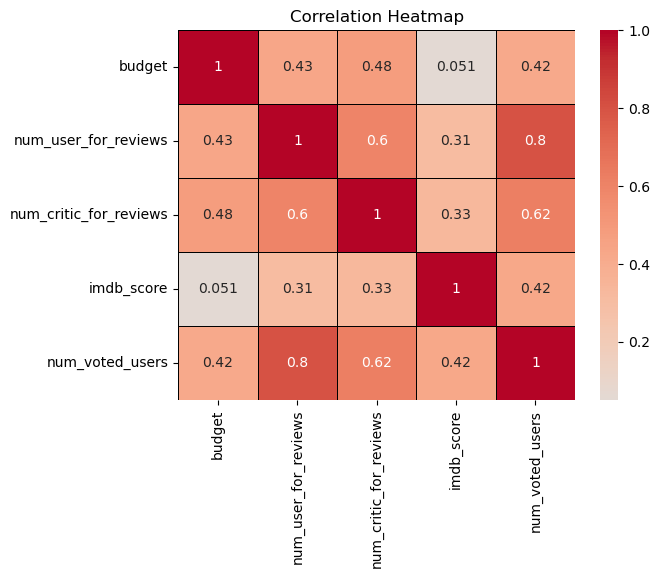

In [84]:
indexes = list(budget_column.index)
t = pd.concat([budget_column.loc[indexes], data.loc[indexes, 'num_user_for_reviews'], data.loc[indexes, 'num_critic_for_reviews'], 
              data.loc[indexes, 'imdb_score'], data.loc[indexes, 'num_voted_users']], axis=1)

correlation_matrix = t.corr()
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', center=0, linewidths=0.5, linecolor='black')
plt.title('Correlation Heatmap')
plt.show()

# Country

## Inspecting data

In [87]:
country_column = data['country']
country_column.value_counts()

country
USA                     3640
UK                       424
France                   153
Canada                   122
Germany                   94
Australia                 52
India                     34
Spain                     33
China                     28
Italy                     22
Japan                     21
Mexico                    17
Hong Kong                 17
South Korea               14
New Zealand               13
Ireland                   12
Russia                    11
Denmark                   11
Brazil                     8
South Africa               8
Norway                     7
Sweden                     6
Thailand                   5
Netherlands                5
Iran                       4
Israel                     4
Argentina                  4
Romania                    4
West Germany               3
Switzerland                3
Poland                     3
Belgium                    3
Czech Republic             3
Hungary                    2
Icelan

In [88]:
country_column.isna().sum()

4

In [89]:
country_column = country_column.dropna()

In [90]:
is_USA_column = (data['country']) == 'USA'
is_USA_column.name = 'is_USA'

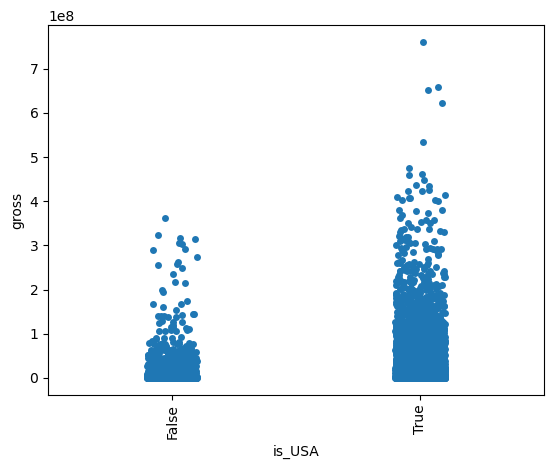

In [91]:
indexes = []
for index in gross_column.index:
    if index in is_USA_column.index:
        indexes.append(index)
t = pd.concat([gross_column.loc[indexes], is_USA_column.loc[indexes]], axis=1)
sns.stripplot(data=t, x='is_USA', y='gross')
plt.xticks(rotation=90)
plt.show()

## Trying models

In [93]:
indexes = []
for index in gross_column.index:
    if index in budget_column.index and index in is_USA_column.index:
        indexes.append(index)
t = pd.concat([gross_column.loc[indexes], budget_column.loc[indexes], is_USA_column.loc[indexes]], axis=1)
t = t.dropna()
y = t['gross'].to_frame()
X = t.drop(columns='gross')
X_train_val, X_test, y_train_val, y_test = train_test_split(X, y, test_size=0.2, random_state=2)
res = runCrossValidationAll(X_train_val, y_train_val)

In [94]:
for name, scores in res.items():
    print(name, scores['mean_test_mse'], scores['std_test_mse'])

SGDRegressor 0.006372895805664122 0.0008695759633650831
RandomForestRegressor 0.006421776448804863 0.0007676494143941025
GradientBoostingRegressor 0.006916327150185993 0.0009810150599138883
XGBRegressor 0.006878974757541355 0.0009636897053453724
LGBMRegressor 0.006860016354763643 0.0009984227523042349


# Genres

## Inspecting data

In [97]:
cnt = {}
for genres in data['genres']:
    for genre in genres.split('|'):
        cnt[genre] = cnt.get(genre, 0) + 1
cnt

{'Action': 1095,
 'Adventure': 878,
 'Fantasy': 570,
 'Sci-Fi': 580,
 'Thriller': 1340,
 'Documentary': 120,
 'Animation': 233,
 'Comedy': 1815,
 'Family': 524,
 'Musical': 131,
 'Romance': 1071,
 'Mystery': 461,
 'Western': 94,
 'Drama': 2471,
 'History': 201,
 'Sport': 176,
 'Crime': 839,
 'Horror': 533,
 'War': 208,
 'Biography': 290,
 'Music': 211,
 'News': 3,
 'Short': 5,
 'Reality-TV': 1,
 'Film-Noir': 6}

In [98]:
genres = []
for title_genres in data['genres']:
    for genre in title_genres.split('|'):
        if genre not in genres:
            genres.append(genre)
genres

['Action',
 'Adventure',
 'Fantasy',
 'Sci-Fi',
 'Thriller',
 'Documentary',
 'Animation',
 'Comedy',
 'Family',
 'Musical',
 'Romance',
 'Mystery',
 'Western',
 'Drama',
 'History',
 'Sport',
 'Crime',
 'Horror',
 'War',
 'Biography',
 'Music',
 'News',
 'Short',
 'Reality-TV',
 'Film-Noir']

In [99]:
is_genre_columns = data['genres'].to_frame()
def fill_genre(row, genre):
    if genre in row['genres'].split('|'):
        return 1
    else:
        return 0
for genre in genres:
    is_genre_columns[genre] = is_genre_columns.apply(fill_genre, axis=1, genre=genre)
is_genre_columns = is_genre_columns.drop(columns='genres')
is_genre_columns

,Action,Adventure,Fantasy,Sci-Fi,Thriller,Documentary,Animation,Comedy,Family,Musical,Romance,Mystery,Western,Drama,History,Sport,Crime,Horror,War,Biography,Music,News,Short,Reality-TV,Film-Noir
0,1,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,1,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
5,1,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
7,0,1,1,0,0,0,1,1,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0
8,1,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
9,0,1,1,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0
10,1,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


## Trying models

In [101]:
indexes = []
for index in gross_column.index:
    if index in budget_column.index and index in is_USA_column.index and index in is_genre_columns.index:
        indexes.append(index)
t = pd.concat([gross_column.loc[indexes], budget_column.loc[indexes], is_USA_column.loc[indexes], is_genre_columns.loc[indexes]], axis=1)
t = t.dropna()
y = t['gross'].to_frame()
X = t.drop(columns='gross')
X_train_val, X_test, y_train_val, y_test = train_test_split(X, y, test_size=0.2, random_state=2)
res = runCrossValidationAll(X_train_val, y_train_val)

In [102]:
for name, scores in res.items():
    print(name, scores['mean_test_mse'], scores['std_test_mse'])

SGDRegressor 0.006416258282203218 0.000822751322442826
RandomForestRegressor 0.0063247855362714624 0.0006897389240484329
GradientBoostingRegressor 0.006873003400646553 0.0010053536354671785
XGBRegressor 0.006756102488058453 0.0009677204512382718
LGBMRegressor 0.006749550928263398 0.0009929531409443853


In [103]:
indexes = []
for index in gross_column.index:
    if index in budget_column.index:
        indexes.append(index)
t = pd.concat([gross_column.loc[indexes], budget_column.loc[indexes], is_USA_column.loc[indexes], is_genre_columns.loc[indexes]], axis=1)
t = t.dropna()
y = t['gross'].to_frame()
X = t.drop(columns='gross')
X_train_val, X_test, y_train_val, y_test = train_test_split(X, y, test_size=0.2, random_state=2)
logging.getLogger('lightgbm').setLevel(logging.ERROR)
res = runCrossValidationLGBMRegressor(X_train_val, y_train_val)
res.sort_values(by='mean_test_mse')

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_learning_rate,param_n_estimators,param_reg_lambda,params,split0_test_mae,split1_test_mae,split2_test_mae,split3_test_mae,split4_test_mae,mean_test_mae,std_test_mae,rank_test_mae,split0_train_mae,split1_train_mae,split2_train_mae,split3_train_mae,split4_train_mae,mean_train_mae,std_train_mae,split0_test_mse,split1_test_mse,split2_test_mse,split3_test_mse,split4_test_mse,mean_test_mse,std_test_mse,rank_test_mse,split0_train_mse,split1_train_mse,split2_train_mse,split3_train_mse,split4_train_mse,mean_train_mse,std_train_mse,split0_test_mape,split1_test_mape,split2_test_mape,split3_test_mape,split4_test_mape,mean_test_mape,std_test_mape,rank_test_mape,split0_train_mape,split1_train_mape,split2_train_mape,split3_train_mape,split4_train_mape,mean_train_mape,std_train_mape,split0_test_r2,split1_test_r2,split2_test_r2,split3_test_r2,split4_test_r2,mean_test_r2,std_test_r2,rank_test_r2,split0_train_r2,split1_train_r2,split2_train_r2,split3_train_r2,split4_train_r2,mean_train_r2,std_train_r2
39,0.101857,0.001703,0.004584,0.000149,0.01,300,10,"{'learning_rate': 0.01, 'n_estimators': 300, '...",0.044231,0.050523,0.047569,0.050298,0.049621,0.048448,0.002352,80,0.045705,0.044549,0.045046,0.044442,0.044581,0.044865,0.000469,0.004986,0.006158,0.006063,0.007200,0.006774,0.006236,0.000751,80,0.005463,0.005304,0.005297,0.005032,0.005129,0.005245,0.000150,86.586194,46.615779,70.259050,7.964933e+10,646.680280,1.592987e+10,3.185973e+10,24,2.002028e+10,1.885485e+10,2.192201e+10,238.470821,1.817266e+10,1.579396e+10,7.998640e+09,0.420909,0.456599,0.377965,0.443408,0.371334,0.414043,0.034194,1,0.512479,0.495860,0.515059,0.503100,0.519164,0.509132,0.008479
35,0.100640,0.002288,0.004656,0.000276,0.01,300,0,"{'learning_rate': 0.01, 'n_estimators': 300, '...",0.044708,0.050892,0.047719,0.050607,0.049625,0.048710,0.002289,79,0.044818,0.043868,0.044299,0.043512,0.043698,0.044039,0.000469,0.005068,0.006296,0.006036,0.007177,0.006746,0.006264,0.000714,79,0.005155,0.005028,0.005008,0.004738,0.004857,0.004957,0.000145,82.878086,48.122481,68.299518,7.806411e+10,681.274941,1.561282e+10,3.122564e+10,25,1.981699e+10,1.957652e+10,2.079458e+10,232.424996,1.804716e+10,1.564705e+10,7.872952e+09,0.411409,0.444427,0.380752,0.445227,0.373924,0.411148,0.030261,2,0.539937,0.522122,0.541590,0.532135,0.544649,0.536087,0.008112
36,0.100586,0.001630,0.004613,0.000085,0.01,300,0.1,"{'learning_rate': 0.01, 'n_estimators': 300, '...",0.044621,0.051125,0.047721,0.050575,0.049646,0.048738,0.002361,78,0.044940,0.043824,0.044303,0.043543,0.043735,0.044069,0.000502,0.005051,0.006299,0.006016,0.007223,0.006754,0.006269,0.000734,78,0.005171,0.005025,0.005012,0.004768,0.004848,0.004965,0.000142,80.065454,52.686445,67.711679,8.155141e+10,677.193708,1.631028e+10,3.262056e+10,21,1.956631e+10,1.963173e+10,2.116373e+10,219.040689,1.799063e+10,1.567048e+10,7.899265e+09,0.413303,0.444133,0.382738,0.441700,0.373228,0.411021,0.029227,3,0.538507,0.522349,0.541209,0.529146,0.545484,0.535339,0.008420
37,0.100309,0.001918,0.004665,0.000238,0.01,300,0.5,"{'learning_rate': 0.01, 'n_estimators': 300, '...",0.044619,0.050914,0.047841,0.050553,0.049773,0.048740,0.002318,77,0.044942,0.043887,0.044332,0.043632,0.043852,0.044129,0.000466,0.005032,0.006283,0.006056,0.007219,0.006762,0.006270,0.000738,77,0.005190,0.005042,0.005031,0.004798,0.004883,0.004989,0.000136,82.732216,51.379403,66.364356,8.098586e+10,687.462891,1.619717e+10,3.239434e+10,22,1.984393e+10,1.961021e+10,2.145430e+10,218.466067,1.782988e+10,1.574766e+10,7.957246e+09,0.415511,0.445561,0.378644,0.441984,0.372511,0.410842,0.030669,4,0.536862,0.520773,0.539487,0.526221,0.542222,0.533113,0.008215
38,0.102192,0.001146,0.004742,0.000283,0.01,300,1,"{'learning_rate': 0.01, 'n_estimators': 300, '...",0.044497,0.051080,0.047877,0.050516,0.049879,0.048770,0.002395,76,0.045006,0.043917,0.044432,0.043695,0.043921,0.044194,0.000473,0.005013,0.006288,0.006093,0.007238,0.006765,0.006280,0.000747

In [104]:
indexes = []
for index in gross_column.index:
    if index in budget_column.index:
        indexes.append(index)
t = pd.concat([gross_column.loc[indexes], budget_column.loc[indexes], is_USA_column.loc[indexes], is_genre_columns.loc[indexes]], axis=1)
t = t.dropna()
y = t['gross'].to_frame()
X = t.drop(columns='gross')
X_train_val, X_test, y_train_val, y_test = train_test_split(X, y, test_size=0.2, random_state=2)
res = runCrossValidationRandomForestRegressor(X_train_val, y_train_val)
res.sort_values(by='mean_test_mse')

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_max_depth,param_min_samples_leaf,param_min_samples_split,param_n_estimators,params,split0_test_mae,split1_test_mae,split2_test_mae,split3_test_mae,split4_test_mae,mean_test_mae,std_test_mae,rank_test_mae,split0_train_mae,split1_train_mae,split2_train_mae,split3_train_mae,split4_train_mae,mean_train_mae,std_train_mae,split0_test_mse,split1_test_mse,split2_test_mse,split3_test_mse,split4_test_mse,mean_test_mse,std_test_mse,rank_test_mse,split0_train_mse,split1_train_mse,split2_train_mse,split3_train_mse,split4_train_mse,mean_train_mse,std_train_mse,split0_test_mape,split1_test_mape,split2_test_mape,split3_test_mape,split4_test_mape,mean_test_mape,std_test_mape,rank_test_mape,split0_train_mape,split1_train_mape,split2_train_mape,split3_train_mape,split4_train_mape,mean_train_mape,std_train_mape,split0_test_r2,split1_test_r2,split2_test_r2,split3_test_r2,split4_test_r2,mean_test_r2,std_test_r2,rank_test_r2,split0_train_r2,split1_train_r2,split2_train_r2,split3_train_r2,split4_train_r2,mean_train_r2,std_train_r2
7,0.189052,0.010210,0.007090,0.000532,5,1,20,100,"{'max_depth': 5, 'min_samples_leaf': 1, 'min_s...",0.044910,0.050723,0.047736,0.049713,0.049085,0.048433,0.002010,60,0.046578,0.045321,0.045886,0.045429,0.045404,0.045723,0.000471,0.005111,0.006099,0.005965,0.007061,0.006711,0.006189,0.000671,81,0.005509,0.005320,0.005346,0.005111,0.005178,0.005293,0.000139,75.932289,39.717327,59.233636,5.776877e+10,414.267948,1.155375e+10,2.310751e+10,5,1.902116e+10,1.368038e+10,1.679820e+10,177.834782,1.028188e+10,1.195632e+10,6.664616e+09,0.406361,0.461808,0.388062,0.454155,0.377218,0.417521,0.034409,1,0.508393,0.494361,0.510604,0.495270,0.514552,0.504636,0.008263
8,1.877068,0.044850,0.054620,0.001332,5,1,20,1000,"{'max_depth': 5, 'min_samples_leaf': 1, 'min_s...",0.044609,0.050692,0.047837,0.049976,0.048904,0.048404,0.002130,66,0.046554,0.045285,0.045940,0.045454,0.045261,0.045699,0.000492,0.005035,0.006109,0.006043,0.007110,0.006678,0.006195,0.000700,80,0.005500,0.005328,0.005352,0.005128,0.005162,0.005294,0.000136,75.607723,40.069431,60.368496,5.654488e+10,408.162535,1.130898e+10,2.261795e+10,6,1.898947e+10,1.263665e+10,1.642381e+10,174.799667,9.959816e+09,1.160195e+10,6.575687e+09,0.415142,0.460924,0.380033,0.450372,0.380271,0.417348,0.033945,2,0.509143,0.493559,0.510040,0.493565,0.516015,0.504464,0.009210
60,0.030670,0.000544,0.002042,0.000090,50,1,20,10,"{'max_depth': 50, 'min_samples_leaf': 1, 'min_...",0.045881,0.050770,0.048384,0.050515,0.050359,0.049182,0.001856,16,0.040681,0.039877,0.040866,0.040651,0.040521,0.040519,0.000340,0.005278,0.006000,0.005950,0.007017,0.006759,0.006201,0.000622,79,0.004488,0.004353,0.004342,0.004219,0.004319,0.004344,0.000086,40.565546,57.258947,46.165224,2.192703e+10,295.694974,4.385406e+09,8.770811e+09,58,3.842296e+09,6.894986e+09,4.946739e+09,115.040301,4.656347e+09,4.068074e+09,2.267587e+09,0.386933,0.470562,0.389564,0.457558,0.372790,0.415481,0.040283,5,0.599457,0.586228,0.602490,0.583382,0.595089,0.593329,0.007402
49,0.286669,0.015215,0.010022,0.001020,20,20,5,100,"{'max_depth': 20, 'min_samples_leaf': 20, 'min...",0.044325,0.050732,0.047764,0.049431,0.049236,0.048298,0.002198,78,0.046284,0.045239,0.045784,0.045333,0.045243,0.045576,0.000407,0.004972,0.006119,0.006022,0.007089,0.006835,0.006207,0.000740,78,0.005786,0.005628,0.005569,0.005367,0.005412,0.005552,0.000152,58.248371,40.641999,55.571433,3.674175e+10,324.603172,7.348351e+09,1.469670e+10,36,8.103707e+09,7.790875e+09,1.046840e+10,191.705591,6.977124e+09,6.668021e+09,3.530522e+09,0.422526,0.460040,0.382205,0.451993,0.365704,0.416494,0.037278,3,0.483612,0.465037,0.490229,0.470007,0.492666,0.480310,0.010967
72,0.022092,0.000234,0.001903,0.000013,50,20,2,10,"{'max_depth': 50, 'min_samples_leaf': 20, 'min...",0.044277,0.051164,0.047180,0.049599,0.049751,0.048394,0.002425,67,0.046640,0.045462,0.045656,0.045476,0.045585,0.045764,0.000444,0.004967,0.006139,0.005903,0.007088,0.00696

In [144]:
indexes = []
for index in gross_column.index:
    if index in budget_column.index and index in is_USA_column.index and index in is_genre_columns.index:
        indexes.append(index)
t = pd.concat([gross_column.loc[indexes], budget_column.loc[indexes], is_USA_column.loc[indexes], is_genre_columns['Drama'].loc[indexes],
              is_genre_columns['Comedy'].loc[indexes], is_genre_columns['Thriller'].loc[indexes]], axis=1)
t = t.dropna()
y = t['gross'].to_frame()
X = t.drop(columns='gross')
X_train_val, X_test, y_train_val, y_test = train_test_split(X, y, test_size=0.2, random_state=2)

# Model selection

In [146]:
indexes = []
for index in gross_column.index:
    if index in budget_column.index and index in is_USA_column.index and index in is_genre_columns.index:
        indexes.append(index)
t = pd.concat([gross_column.loc[indexes], budget_column.loc[indexes], is_USA_column.loc[indexes], is_genre_columns.loc[indexes]], axis=1)
t = t.dropna()
y = t['gross'].to_frame()
X = t.drop(columns='gross')
X_train_val, X_test, y_train_val, y_test = train_test_split(X, y, test_size=0.2, random_state=2)
X_scaler = MinMaxScaler()
y_scaler = MinMaxScaler()
X_train_val = X_scaler.fit_transform(X_train_val)
y_train_val = y_scaler.fit_transform(y_train_val)
y_train_val = np.array(y_train_val).reshape((-1))

## Models tuning

### SGDRegressor

Score on fold = 0.006031367807776167
Score on fold = 0.006656061244104505
Score on fold = 0.005572714589569628
Score on fold = 0.006640997002405164
Score on fold = 0.006417568901067938
Mean score = 0.006263741908984681


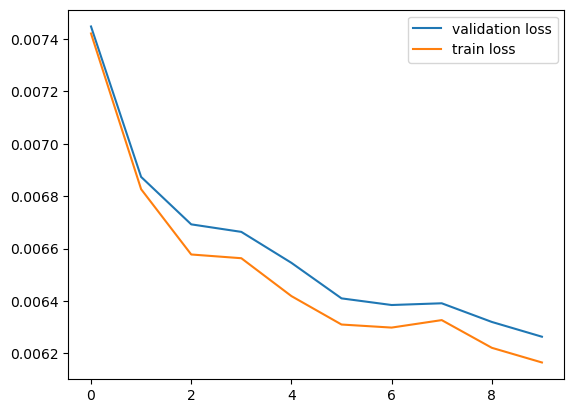

In [149]:
folds = 5
kf = KFold(n_splits=folds, shuffle=True, random_state=1)
n_iterations = 10
val_loss = np.zeros(n_iterations)
train_loss = np.zeros(n_iterations)
mean_score = 0
for train_index, val_index in kf.split(X_train_val):
    model = SGDRegressor(learning_rate='constant', early_stopping=False, max_iter=1000000, eta0=0.01)
    for i in range(n_iterations):
        model.partial_fit(X_train_val[train_index], y_train_val[train_index])
        y_pred = model.predict(X_train_val[val_index])
        loss = mean_squared_error(y_train_val[val_index], y_pred)
        val_loss[i] += loss
        y_pred = model.predict(X_train_val[train_index])
        loss = mean_squared_error(y_train_val[train_index], y_pred)
        train_loss[i] += loss
    y_pred = model.predict(X_train_val[val_index])
    score = mean_squared_error(y_train_val[val_index], y_pred)
    print(f"Score on fold = {score}")
    mean_score += score
mean_score /= folds
print(f"Mean score = {mean_score}")
val_loss /= folds
train_loss /= folds
plt.plot(val_loss, label='validation loss')
plt.plot(train_loss, label='train loss')
plt.legend(loc='best')
plt.show()

Score on fold = 0.005972076910462646
Score on fold = 0.006608633122047585
Score on fold = 0.005528874773205274
Score on fold = 0.00655878615429344
Score on fold = 0.00641076870892936
Mean score = 0.006215827933787661


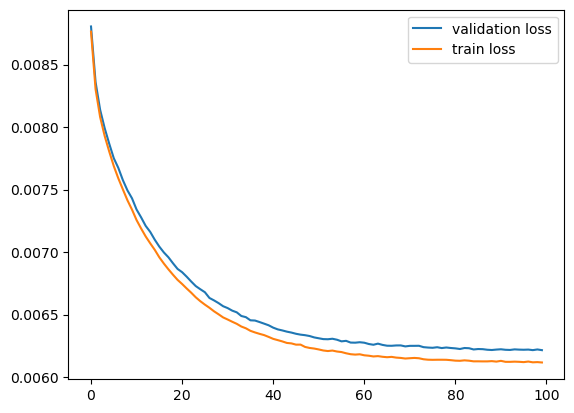

In [150]:
folds = 5
kf = KFold(n_splits=folds, shuffle=True, random_state=1)
n_iterations = 100
val_loss = np.zeros(n_iterations)
train_loss = np.zeros(n_iterations)
mean_score = 0
for train_index, val_index in kf.split(X_train_val):
    model = SGDRegressor(learning_rate='constant', early_stopping=False, max_iter=1000000, eta0=0.001)
    for i in range(n_iterations):
        model.partial_fit(X_train_val[train_index], y_train_val[train_index])
        y_pred = model.predict(X_train_val[val_index])
        loss = mean_squared_error(y_train_val[val_index], y_pred)
        val_loss[i] += loss
        y_pred = model.predict(X_train_val[train_index])
        loss = mean_squared_error(y_train_val[train_index], y_pred)
        train_loss[i] += loss
    y_pred = model.predict(X_train_val[val_index])
    score = mean_squared_error(y_train_val[val_index], y_pred)
    print(f"Score on fold = {score}")
    mean_score += score
mean_score /= folds
print(f"Mean score = {mean_score}")
val_loss /= folds
train_loss /= folds
plt.plot(val_loss, label='validation loss')
plt.plot(train_loss, label='train loss')
plt.legend(loc='best')
plt.show()

### RandomForestRegressor

In [152]:
folds = 5
kf = KFold(n_splits=folds, shuffle=True, random_state=1)
mean_score = 0
for train_index, val_index in kf.split(X_train_val):
    model = RandomForestRegressor(n_estimators=40, max_depth=10, min_samples_split=25, min_samples_leaf=3)
    model.fit(X_train_val[train_index], y_train_val[train_index])
    y_pred = model.predict(X_train_val[val_index])
    score = mean_squared_error(y_train_val[val_index], y_pred)
    print(f"Score on fold = {score}")
    mean_score += score
mean_score /= folds
print(f"Mean score = {mean_score}")

Score on fold = 0.005983326589699214
Score on fold = 0.006213857697651741
Score on fold = 0.00545189918270374
Score on fold = 0.006535630964251033
Score on fold = 0.006299851233788484
Mean score = 0.006096913133618842


Mean score = 0.00711604306280979


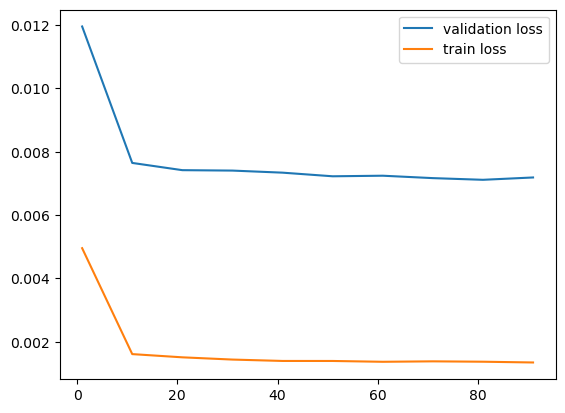

In [153]:
folds = 5
kf = KFold(n_splits=folds, shuffle=True, random_state=1)
mean_score = 0
n_estimators_range = np.arange(1, 100, 10)
val_loss = np.zeros(len(n_estimators_range))
train_loss = np.zeros(len(n_estimators_range))
for train_index, val_index in kf.split(X_train_val):
    i = 0
    for n_estimators in n_estimators_range:
        model = RandomForestRegressor(n_estimators=n_estimators)
        model.fit(X_train_val[train_index], y_train_val[train_index])
        y_pred = model.predict(X_train_val[val_index])
        loss = mean_squared_error(y_train_val[val_index], y_pred)
        val_loss[i] += loss
        y_pred = model.predict(X_train_val[train_index])
        loss = mean_squared_error(y_train_val[train_index], y_pred)
        train_loss[i] += loss
        i += 1
val_loss /= folds
train_loss /= folds
mean_score = val_loss.min()
print(f"Mean score = {mean_score}")
plt.plot(n_estimators_range, val_loss, label='validation loss')
plt.plot(n_estimators_range, train_loss, label='train loss')
plt.legend(loc='best')
plt.show()

Mean score = 0.006237869305862206


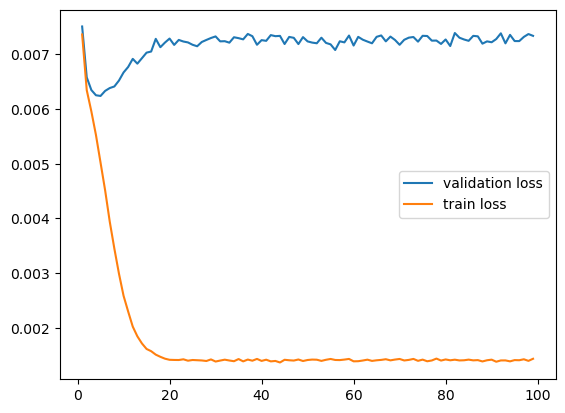

In [154]:
folds = 5
kf = KFold(n_splits=folds, shuffle=True, random_state=1)
mean_score = 0
max_depth_range = np.arange(1, 100, 1)
val_loss = np.zeros(len(max_depth_range))
train_loss = np.zeros(len(max_depth_range))
for train_index, val_index in kf.split(X_train_val):
    i = 0
    for max_depth in max_depth_range:
        model = RandomForestRegressor(n_estimators=40, max_depth=max_depth)
        model.fit(X_train_val[train_index], y_train_val[train_index])
        y_pred = model.predict(X_train_val[val_index])
        loss = mean_squared_error(y_train_val[val_index], y_pred)
        val_loss[i] += loss
        y_pred = model.predict(X_train_val[train_index])
        loss = mean_squared_error(y_train_val[train_index], y_pred)
        train_loss[i] += loss
        i += 1
val_loss /= folds
train_loss /= folds
mean_score = val_loss.min()
print(f"Mean score = {mean_score}")
plt.plot(max_depth_range, val_loss, label='validation loss')
plt.plot(max_depth_range, train_loss, label='train loss')
plt.legend(loc='best')
plt.show()

Mean score = 0.006062595226522513


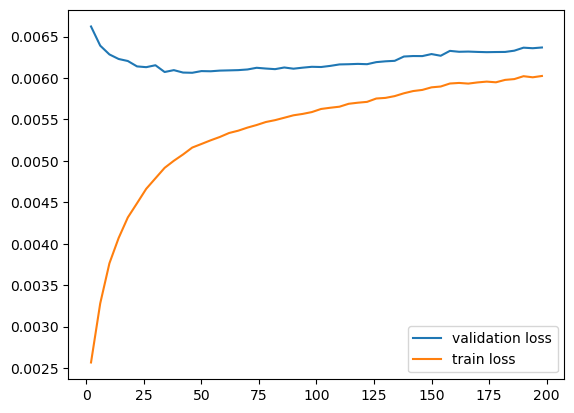

In [155]:
folds = 5
kf = KFold(n_splits=folds, shuffle=True, random_state=1)
mean_score = 0
min_samples_split_range = np.arange(2, 200, 4)
val_loss = np.zeros(len(min_samples_split_range))
train_loss = np.zeros(len(min_samples_split_range))
for train_index, val_index in kf.split(X_train_val):
    i = 0
    for min_samples_split in min_samples_split_range:
        model = RandomForestRegressor(n_estimators=100, max_depth=10, min_samples_leaf=1, 
                                      min_samples_split=min_samples_split)
        model.fit(X_train_val[train_index], y_train_val[train_index])
        y_pred = model.predict(X_train_val[val_index])
        loss = mean_squared_error(y_train_val[val_index], y_pred)
        val_loss[i] += loss
        y_pred = model.predict(X_train_val[train_index])
        loss = mean_squared_error(y_train_val[train_index], y_pred)
        train_loss[i] += loss
        i += 1
val_loss /= folds
train_loss /= folds
mean_score = val_loss.min()
print(f"Mean score = {mean_score}")
plt.plot(min_samples_split_range, val_loss, label='validation loss')
plt.plot(min_samples_split_range, train_loss, label='train loss')
plt.legend(loc='best')
plt.show()

Mean score = 0.00606909071624172


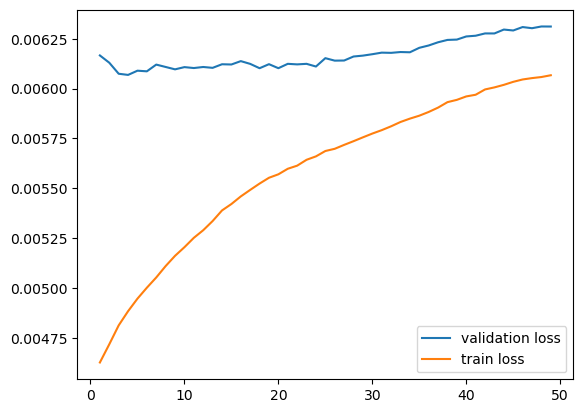

In [156]:
folds = 5
kf = KFold(n_splits=folds, shuffle=True, random_state=1)
mean_score = 0
min_samples_leaf_range = np.arange(1, 50, 1)
val_loss = np.zeros(len(min_samples_leaf_range))
train_loss = np.zeros(len(min_samples_leaf_range))
for train_index, val_index in kf.split(X_train_val):
    i = 0
    for min_samples_leaf in min_samples_leaf_range:
        model = RandomForestRegressor(n_estimators=100, max_depth=10, min_samples_leaf=min_samples_leaf, 
                                      min_samples_split=25)
        model.fit(X_train_val[train_index], y_train_val[train_index])
        y_pred = model.predict(X_train_val[val_index])
        loss = mean_squared_error(y_train_val[val_index], y_pred)
        val_loss[i] += loss
        y_pred = model.predict(X_train_val[train_index])
        loss = mean_squared_error(y_train_val[train_index], y_pred)
        train_loss[i] += loss
        i += 1
val_loss /= folds
train_loss /= folds
mean_score = val_loss.min()
print(f"Mean score = {mean_score}")
plt.plot(min_samples_leaf_range, val_loss, label='validation loss')
plt.plot(min_samples_leaf_range, train_loss, label='train loss')
plt.legend(loc='best')
plt.show()

### GradientBoostingRegressor

In [158]:
folds = 5
kf = KFold(n_splits=folds, shuffle=True, random_state=1)
mean_score = 0
for train_index, val_index in kf.split(X_train_val):
    model = GradientBoostingRegressor(n_estimators=34, learning_rate=0.1, max_depth=2)
    model.fit(X_train_val[train_index], y_train_val[train_index])
    y_pred = model.predict(X_train_val[val_index])
    score = mean_squared_error(y_train_val[val_index], y_pred)
    print(f"Score on fold = {score}")
    mean_score += score
mean_score /= folds
print(f"Mean score = {mean_score}")

Score on fold = 0.0060588452142607
Score on fold = 0.006478731466725489
Score on fold = 0.005544558989191988
Score on fold = 0.006518977917178719
Score on fold = 0.00639823465988881
Mean score = 0.0061998696494491405


Mean score = 0.0061922589860620965


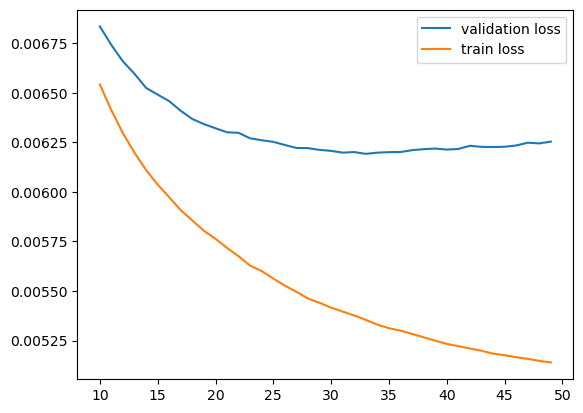

In [159]:
folds = 5
kf = KFold(n_splits=folds, shuffle=True, random_state=1)
mean_score = 0
n_estimators_range = np.arange(10, 50, 1)
val_loss = np.zeros(len(n_estimators_range))
train_loss = np.zeros(len(n_estimators_range))
for train_index, val_index in kf.split(X_train_val):
    i = 0
    for n_estimators in n_estimators_range:
        model = GradientBoostingRegressor(n_estimators=n_estimators)
        model.fit(X_train_val[train_index], y_train_val[train_index])
        y_pred = model.predict(X_train_val[val_index])
        loss = mean_squared_error(y_train_val[val_index], y_pred)
        val_loss[i] += loss
        y_pred = model.predict(X_train_val[train_index])
        loss = mean_squared_error(y_train_val[train_index], y_pred)
        train_loss[i] += loss
        i += 1
val_loss /= folds
train_loss /= folds
mean_score = val_loss.min()
print(f"Mean score = {mean_score}")
plt.plot(n_estimators_range, val_loss, label='validation loss')
plt.plot(n_estimators_range, train_loss, label='train loss')
plt.legend(loc='best')
plt.show()

Mean score = 0.006161361640796633


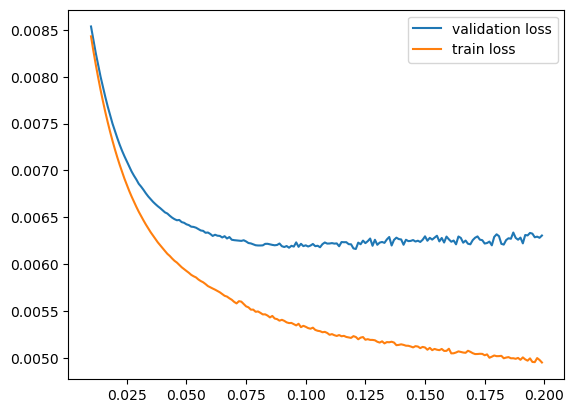

In [160]:
folds = 5
kf = KFold(n_splits=folds, shuffle=True, random_state=1)
mean_score = 0
learning_rate_range = np.arange(0.01, 0.2, 0.001)
val_loss = np.zeros(len(learning_rate_range))
train_loss = np.zeros(len(learning_rate_range))
for train_index, val_index in kf.split(X_train_val):
    i = 0
    for learning_rate in learning_rate_range:
        model = GradientBoostingRegressor(n_estimators=34, learning_rate=learning_rate)
        model.fit(X_train_val[train_index], y_train_val[train_index])
        y_pred = model.predict(X_train_val[val_index])
        loss = mean_squared_error(y_train_val[val_index], y_pred)
        val_loss[i] += loss
        y_pred = model.predict(X_train_val[train_index])
        loss = mean_squared_error(y_train_val[train_index], y_pred)
        train_loss[i] += loss
        i += 1
val_loss /= folds
train_loss /= folds
mean_score = val_loss.min()
print(f"Mean score = {mean_score}")
plt.plot(learning_rate_range, val_loss, label='validation loss')
plt.plot(learning_rate_range, train_loss, label='train loss')
plt.legend(loc='best')
plt.show()

Mean score = 0.006195458850158887


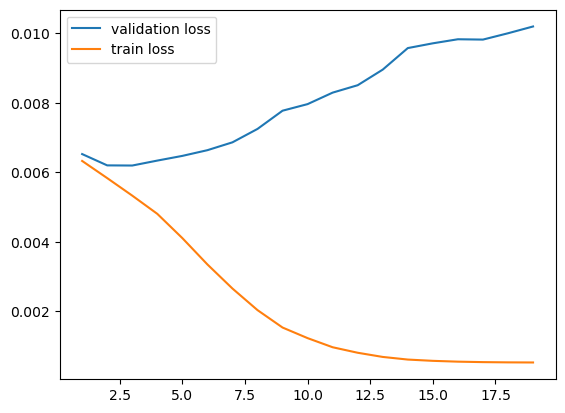

In [161]:
folds = 5
kf = KFold(n_splits=folds, shuffle=True, random_state=1)
mean_score = 0
max_depth_range = np.arange(1, 20, 1)
val_loss = np.zeros(len(max_depth_range))
train_loss = np.zeros(len(max_depth_range))
for train_index, val_index in kf.split(X_train_val):
    i = 0
    for max_depth in max_depth_range:
        model = GradientBoostingRegressor(n_estimators=34, learning_rate=0.1, max_depth=max_depth)
        model.fit(X_train_val[train_index], y_train_val[train_index])
        y_pred = model.predict(X_train_val[val_index])
        loss = mean_squared_error(y_train_val[val_index], y_pred)
        val_loss[i] += loss
        y_pred = model.predict(X_train_val[train_index])
        loss = mean_squared_error(y_train_val[train_index], y_pred)
        train_loss[i] += loss
        i += 1
val_loss /= folds
train_loss /= folds
mean_score = val_loss.min()
print(f"Mean score = {mean_score}")
plt.plot(max_depth_range, val_loss, label='validation loss')
plt.plot(max_depth_range, train_loss, label='train loss')
plt.legend(loc='best')
plt.show()

Mean score = 0.0061998696494491405


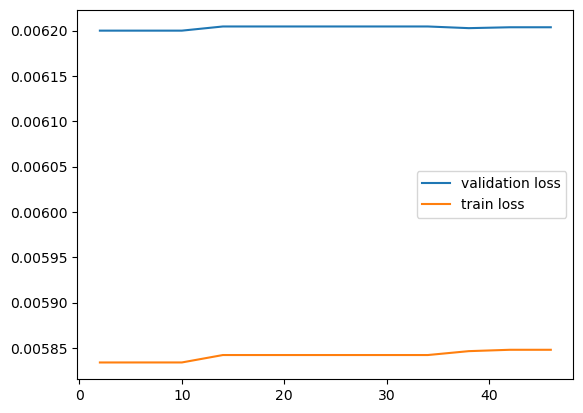

In [162]:
folds = 5
kf = KFold(n_splits=folds, shuffle=True, random_state=1)
mean_score = 0
min_samples_split_range = np.arange(2, 50, 4)
val_loss = np.zeros(len(min_samples_split_range))
train_loss = np.zeros(len(min_samples_split_range))
for train_index, val_index in kf.split(X_train_val):
    i = 0
    for min_samples_split in min_samples_split_range:
        model = GradientBoostingRegressor(n_estimators=34, learning_rate=0.1, max_depth=2, min_samples_split=min_samples_split)
        model.fit(X_train_val[train_index], y_train_val[train_index])
        y_pred = model.predict(X_train_val[val_index])
        loss = mean_squared_error(y_train_val[val_index], y_pred)
        val_loss[i] += loss
        y_pred = model.predict(X_train_val[train_index])
        loss = mean_squared_error(y_train_val[train_index], y_pred)
        train_loss[i] += loss
        i += 1
val_loss /= folds
train_loss /= folds
mean_score = val_loss.min()
print(f"Mean score = {mean_score}")
plt.plot(min_samples_split_range, val_loss, label='validation loss')
plt.plot(min_samples_split_range, train_loss, label='train loss')
plt.legend(loc='best')
plt.show()

Mean score = 0.006170818929506118


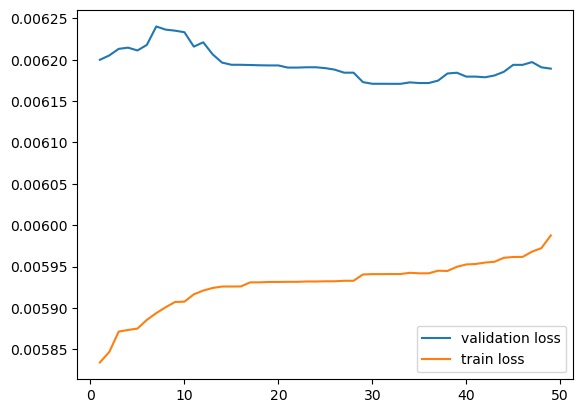

In [163]:
folds = 5
kf = KFold(n_splits=folds, shuffle=True, random_state=1)
mean_score = 0
min_samples_leaf_range = np.arange(1, 50, 1)
val_loss = np.zeros(len(min_samples_leaf_range))
train_loss = np.zeros(len(min_samples_leaf_range))
for train_index, val_index in kf.split(X_train_val):
    i = 0
    for min_samples_leaf in min_samples_leaf_range:
        model = GradientBoostingRegressor(n_estimators=34, learning_rate=0.1, max_depth=2, min_samples_split=2, 
                                      min_samples_leaf=min_samples_leaf)
        model.fit(X_train_val[train_index], y_train_val[train_index])
        y_pred = model.predict(X_train_val[val_index])
        loss = mean_squared_error(y_train_val[val_index], y_pred)
        val_loss[i] += loss
        y_pred = model.predict(X_train_val[train_index])
        loss = mean_squared_error(y_train_val[train_index], y_pred)
        train_loss[i] += loss
        i += 1
val_loss /= folds
train_loss /= folds
mean_score = val_loss.min()
print(f"Mean score = {mean_score}")
plt.plot(min_samples_leaf_range, val_loss, label='validation loss')
plt.plot(min_samples_leaf_range, train_loss, label='train loss')
plt.legend(loc='best')
plt.show()

Mean score = 0.006170872117458024


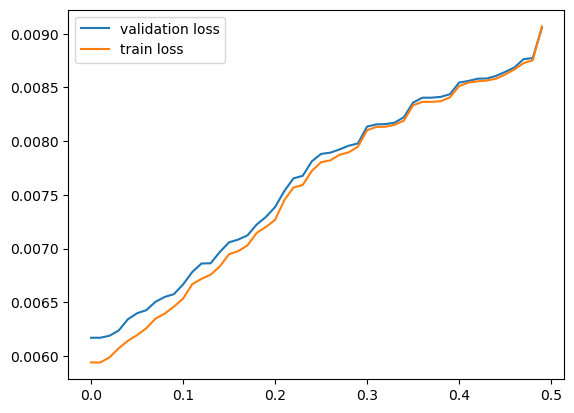

In [164]:
folds = 5
kf = KFold(n_splits=folds, shuffle=True, random_state=1)
mean_score = 0
min_weight_fraction_leaf_range = np.arange(0, 0.5, 0.01)
val_loss = np.zeros(len(min_weight_fraction_leaf_range))
train_loss = np.zeros(len(min_weight_fraction_leaf_range))
for train_index, val_index in kf.split(X_train_val):
    i = 0
    for min_weight_fraction_leaf in min_weight_fraction_leaf_range:
        model = GradientBoostingRegressor(n_estimators=34, learning_rate=0.1, max_depth=2, min_samples_split=2, 
                                      min_samples_leaf=30, min_weight_fraction_leaf=min_weight_fraction_leaf)
        model.fit(X_train_val[train_index], y_train_val[train_index])
        y_pred = model.predict(X_train_val[val_index])
        loss = mean_squared_error(y_train_val[val_index], y_pred)
        val_loss[i] += loss
        y_pred = model.predict(X_train_val[train_index])
        loss = mean_squared_error(y_train_val[train_index], y_pred)
        train_loss[i] += loss
        i += 1
val_loss /= folds
train_loss /= folds
mean_score = val_loss.min()
print(f"Mean score = {mean_score}")
plt.plot(min_weight_fraction_leaf_range, val_loss, label='validation loss')
plt.plot(min_weight_fraction_leaf_range, train_loss, label='train loss')
plt.legend(loc='best')
plt.show()

### XGBRegressor

In [166]:
folds = 5
kf = KFold(n_splits=folds, shuffle=True, random_state=1)
mean_score = 0
for train_index, val_index in kf.split(X_train_val):
    model = xgb.XGBRegressor(objective='reg:squarederror', n_estimators=6, max_depth=5, learning_rate=0.35)
    model.fit(X_train_val[train_index], y_train_val[train_index])
    y_pred = model.predict(X_train_val[val_index])
    score = mean_squared_error(y_train_val[val_index], y_pred)
    print(f"Score on fold = {score}")
    mean_score += score
mean_score /= folds
print(f"Mean score = {mean_score}")

Score on fold = 0.006159593162340928
Score on fold = 0.006165433328368661
Score on fold = 0.005415896667965554
Score on fold = 0.006794334217733101
Score on fold = 0.006267092839043175
Mean score = 0.006160470043090284


Mean score = 0.00636766801141775


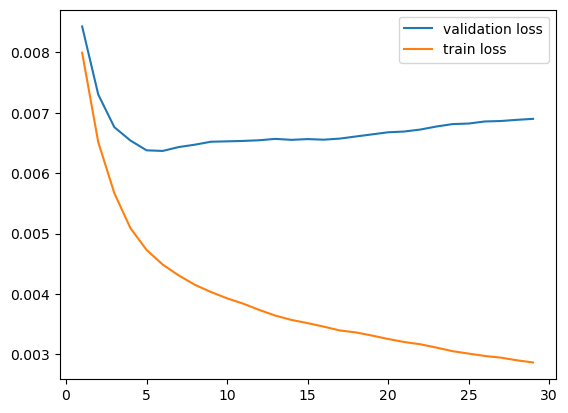

In [167]:
folds = 5
kf = KFold(n_splits=folds, shuffle=True, random_state=1)
mean_score = 0
n_estimators_range = np.arange(1, 30, 1)
val_loss = np.zeros(len(n_estimators_range))
train_loss = np.zeros(len(n_estimators_range))
for train_index, val_index in kf.split(X_train_val):
    i = 0
    for n_estimators in n_estimators_range:
        model = xgb.XGBRegressor(objective='reg:squarederror', n_estimators=n_estimators)
        model.fit(X_train_val[train_index], y_train_val[train_index])
        y_pred = model.predict(X_train_val[val_index])
        loss = mean_squared_error(y_train_val[val_index], y_pred)
        val_loss[i] += loss
        y_pred = model.predict(X_train_val[train_index])
        loss = mean_squared_error(y_train_val[train_index], y_pred)
        train_loss[i] += loss
        i += 1
val_loss /= folds
train_loss /= folds
mean_score = val_loss.min()
print(f"Mean score = {mean_score}")
plt.plot(n_estimators_range, val_loss, label='validation loss')
plt.plot(n_estimators_range, train_loss, label='train loss')
plt.legend(loc='best')
plt.show()

Mean score = 0.006266368649666974


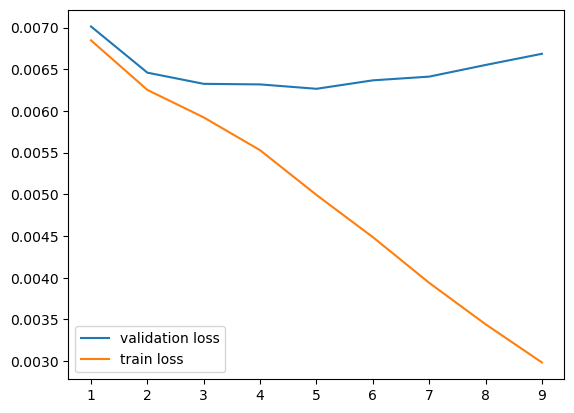

In [168]:
folds = 5
kf = KFold(n_splits=folds, shuffle=True, random_state=1)
mean_score = 0
max_depth_range = np.arange(1, 10, 1)
val_loss = np.zeros(len(max_depth_range))
train_loss = np.zeros(len(max_depth_range))
for train_index, val_index in kf.split(X_train_val):
    i = 0
    for max_depth in max_depth_range:
        model = xgb.XGBRegressor(objective='reg:squarederror', n_estimators=6, max_depth=max_depth)
        model.fit(X_train_val[train_index], y_train_val[train_index])
        y_pred = model.predict(X_train_val[val_index])
        loss = mean_squared_error(y_train_val[val_index], y_pred)
        val_loss[i] += loss
        y_pred = model.predict(X_train_val[train_index])
        loss = mean_squared_error(y_train_val[train_index], y_pred)
        train_loss[i] += loss
        i += 1
val_loss /= folds
train_loss /= folds
mean_score = val_loss.min()
print(f"Mean score = {mean_score}")
plt.plot(max_depth_range, val_loss, label='validation loss')
plt.plot(max_depth_range, train_loss, label='train loss')
plt.legend(loc='best')
plt.show()

Mean score = 0.006246186551846151


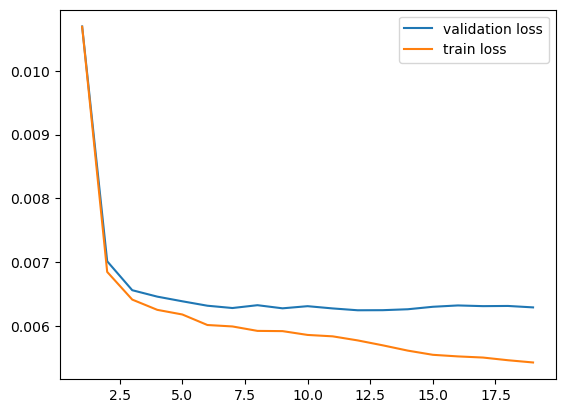

In [169]:
folds = 5
kf = KFold(n_splits=folds, shuffle=True, random_state=1)
mean_score = 0
max_leaves_range = np.arange(1, 20, 1)
val_loss = np.zeros(len(max_leaves_range))
train_loss = np.zeros(len(max_leaves_range))
for train_index, val_index in kf.split(X_train_val):
    i = 0
    for max_leaves in max_leaves_range:
        model = xgb.XGBRegressor(objective='reg:squarederror', n_estimators=6, max_depth=5, max_leaves=max_leaves)
        model.fit(X_train_val[train_index], y_train_val[train_index])
        y_pred = model.predict(X_train_val[val_index])
        loss = mean_squared_error(y_train_val[val_index], y_pred)
        val_loss[i] += loss
        y_pred = model.predict(X_train_val[train_index])
        loss = mean_squared_error(y_train_val[train_index], y_pred)
        train_loss[i] += loss
        i += 1
val_loss /= folds
train_loss /= folds
mean_score = val_loss.min()
print(f"Mean score = {mean_score}")
plt.plot(max_leaves_range, val_loss, label='validation loss')
plt.plot(max_leaves_range, train_loss, label='train loss')
plt.legend(loc='best')
plt.show()

Mean score = 0.006160470043090284


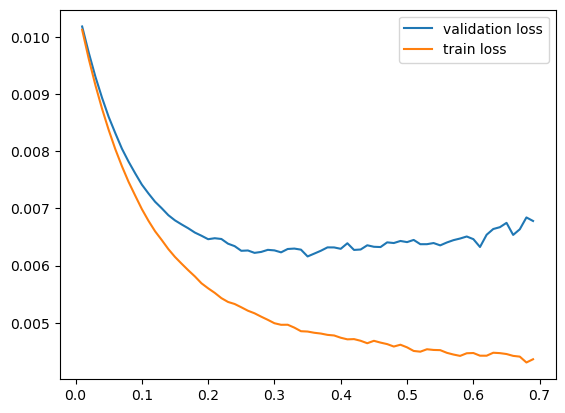

In [170]:
folds = 5
kf = KFold(n_splits=folds, shuffle=True, random_state=1)
mean_score = 0
learning_rate_range = np.arange(0.01, 0.7, 0.01)
val_loss = np.zeros(len(learning_rate_range))
train_loss = np.zeros(len(learning_rate_range))
for train_index, val_index in kf.split(X_train_val):
    i = 0
    for learning_rate in learning_rate_range:
        model = xgb.XGBRegressor(objective='reg:squarederror', n_estimators=6, max_depth=5, learning_rate=learning_rate)
        model.fit(X_train_val[train_index], y_train_val[train_index])
        y_pred = model.predict(X_train_val[val_index])
        loss = mean_squared_error(y_train_val[val_index], y_pred)
        val_loss[i] += loss
        y_pred = model.predict(X_train_val[train_index])
        loss = mean_squared_error(y_train_val[train_index], y_pred)
        train_loss[i] += loss
        i += 1
val_loss /= folds
train_loss /= folds
mean_score = val_loss.min()
print(f"Mean score = {mean_score}")
plt.plot(learning_rate_range, val_loss, label='validation loss')
plt.plot(learning_rate_range, train_loss, label='train loss')
plt.legend(loc='best')
plt.show()

### LGBMRegressor

In [172]:
folds = 5
kf = KFold(n_splits=folds, shuffle=True, random_state=1)
mean_score = 0
for train_index, val_index in kf.split(X_train_val):
    model = lgb.LGBMRegressor(objective='regression', metric='rmse', n_estimators=50, max_depth=6)
    model.fit(X_train_val[train_index], y_train_val[train_index])
    y_pred = model.predict(X_train_val[val_index])
    score = mean_squared_error(y_train_val[val_index], y_pred)
    print(f"Score on fold = {score}")
    mean_score += score
mean_score /= folds
print(f"Mean score = {mean_score}")

Score on fold = 0.005908089779540954
Score on fold = 0.006128740432792753
Score on fold = 0.005723593995830032
Score on fold = 0.006442666752561055
Score on fold = 0.006295315003054553
Mean score = 0.0060996811927558695


Mean score = 0.006124739971220347


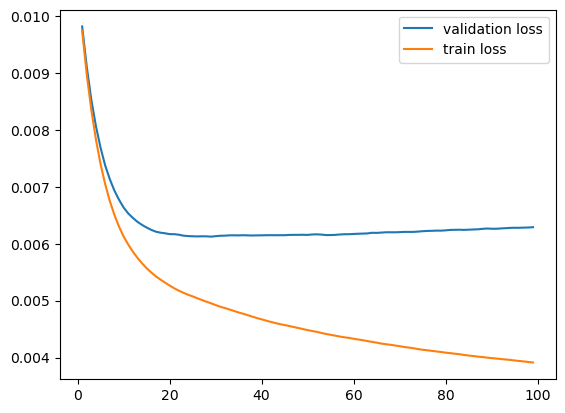

In [173]:
folds = 5
kf = KFold(n_splits=folds, shuffle=True, random_state=1)
mean_score = 0
n_estimators_range = np.arange(1, 100, 1)
val_loss = np.zeros(len(n_estimators_range))
train_loss = np.zeros(len(n_estimators_range))
for train_index, val_index in kf.split(X_train_val):
    i = 0
    for n_estimators in n_estimators_range:
        model = lgb.LGBMRegressor(objective='regression', metric='rmse', n_estimators=n_estimators)
        model.fit(X_train_val[train_index], y_train_val[train_index])
        y_pred = model.predict(X_train_val[val_index])
        loss = mean_squared_error(y_train_val[val_index], y_pred)
        val_loss[i] += loss
        y_pred = model.predict(X_train_val[train_index])
        loss = mean_squared_error(y_train_val[train_index], y_pred)
        train_loss[i] += loss
        i += 1
val_loss /= folds
train_loss /= folds
mean_score = val_loss.min()
print(f"Mean score = {mean_score}")
plt.plot(n_estimators_range, val_loss, label='validation loss')
plt.plot(n_estimators_range, train_loss, label='train loss')
plt.legend(loc='best')
plt.show()

Mean score = 0.0060996811927558695


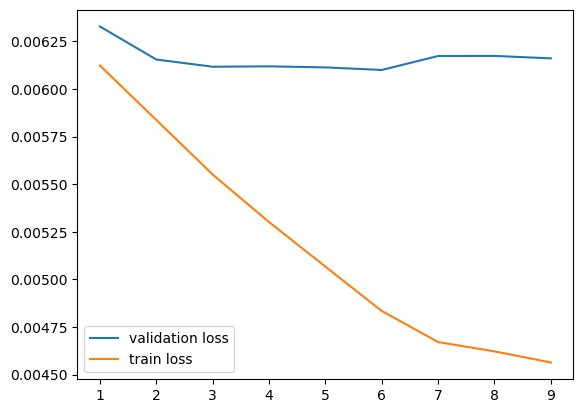

In [174]:
folds = 5
kf = KFold(n_splits=folds, shuffle=True, random_state=1)
mean_score = 0
max_depth_range = np.arange(1, 10, 1)
val_loss = np.zeros(len(max_depth_range))
train_loss = np.zeros(len(max_depth_range))
for train_index, val_index in kf.split(X_train_val):
    i = 0
    for max_depth in max_depth_range:
        model = lgb.LGBMRegressor(objective='regression', metric='rmse', n_estimators=50, max_depth=max_depth)
        model.fit(X_train_val[train_index], y_train_val[train_index])
        y_pred = model.predict(X_train_val[val_index])
        loss = mean_squared_error(y_train_val[val_index], y_pred)
        val_loss[i] += loss
        y_pred = model.predict(X_train_val[train_index])
        loss = mean_squared_error(y_train_val[train_index], y_pred)
        train_loss[i] += loss
        i += 1
val_loss /= folds
train_loss /= folds
mean_score = val_loss.min()
print(f"Mean score = {mean_score}")
plt.plot(max_depth_range, val_loss, label='validation loss')
plt.plot(max_depth_range, train_loss, label='train loss')
plt.legend(loc='best')
plt.show()

Mean score = 0.0060996811927558695


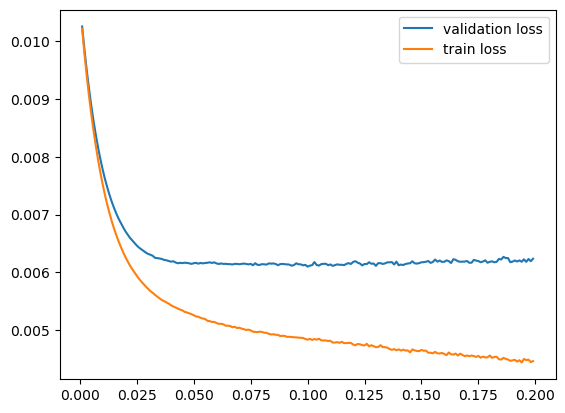

In [175]:
folds = 5
kf = KFold(n_splits=folds, shuffle=True, random_state=1)
mean_score = 0
learning_rate_range = np.arange(0.001, 0.2, 0.001)
val_loss = np.zeros(len(learning_rate_range))
train_loss = np.zeros(len(learning_rate_range))
for train_index, val_index in kf.split(X_train_val):
    i = 0
    for learning_rate in learning_rate_range:
        model = lgb.LGBMRegressor(objective='regression', metric='rmse', n_estimators=50, max_depth=6, learning_rate=learning_rate)
        model.fit(X_train_val[train_index], y_train_val[train_index])
        y_pred = model.predict(X_train_val[val_index])
        loss = mean_squared_error(y_train_val[val_index], y_pred)
        val_loss[i] += loss
        y_pred = model.predict(X_train_val[train_index])
        loss = mean_squared_error(y_train_val[train_index], y_pred)
        train_loss[i] += loss
        i += 1
val_loss /= folds
train_loss /= folds
mean_score = val_loss.min()
print(f"Mean score = {mean_score}")
plt.plot(learning_rate_range, val_loss, label='validation loss')
plt.plot(learning_rate_range, train_loss, label='train loss')
plt.legend(loc='best')
plt.show()

## Making tests

In [177]:
models = [SGDRegressor(learning_rate='constant', early_stopping=False, max_iter=1000000, eta0=0.01), 
          RandomForestRegressor(n_estimators=40, max_depth=10, min_samples_split=25, min_samples_leaf=3),
          GradientBoostingRegressor(n_estimators=34, learning_rate=0.1, max_depth=2),
          xgb.XGBRegressor(objective='reg:squarederror', n_estimators=6, max_depth=5, learning_rate=0.35),
          lgb.LGBMRegressor(objective='regression', metric='rmse', n_estimators=50, max_depth=6)
         ]
for i in range(5):
    for j in range(i + 1, 5):
        model1 = models[i]
        model2 = models[j]
        print(make_scores_test(model1, model2, X_train_val, y_train_val))

0.30824326236256794
0.630977874049576
0.9426113406003138
0.377678097496811
0.542346791898781
0.4325793544023092
0.7676548777076817
0.7999667891923867
0.7335217628774308
0.5485706486367636


In [178]:
for i in range(5):
    for j in range(i + 1, 5):
        model1 = models[i]
        model2 = models[j]
        print(make_predictions_test(model1, model2, X_train_val, y_train_val))

[0.9818760873463085, 0.813767630690837, 0.9287064544788619, 0.9086732016690808, 0.8944700464205844]
[0.9751370332273774, 0.8099920743629918, 0.9994454474239648, 0.7625802972870269, 0.8639083320079353]
[0.9356541796965565, 0.6004241218018387, 0.9457597439234324, 0.9518437209376407, 0.7818783062693272]
[0.6582445485710433, 0.5210253296745606, 0.8650922151364309, 0.9363554531598253, 0.7974808720644614]
[0.9792778359376557, 0.9845414283703889, 0.965212116620126, 0.9595706206121639, 0.9627800455284037]
[0.8644307259419218, 0.8710992803702753, 0.9497093294260882, 0.807639675568682, 0.9215969849547967]
[0.9807767135531968, 0.8617558347627786, 0.8314425737678979, 0.9984064685264653, 0.9400963647780038]
[0.9454020823850744, 0.805264652599522, 0.9132153193262018, 0.8874458380973316, 0.916491689871834]
[0.914466718200324, 0.7777580518129242, 0.8815666472050823, 0.9669756358671829, 0.9329778834445202]
[0.8584514923386983, 0.9756985628801296, 0.795361157895248, 0.8536218832112438, 0.981412972494035

# Error analyzing

In [180]:
indexes = []
for index in gross_column.index:
    if index in budget_column.index and index in is_USA_column.index and index in is_genre_columns.index:
        indexes.append(index)
t = pd.concat([gross_column.loc[indexes], budget_column.loc[indexes], is_USA_column.loc[indexes], is_genre_columns.loc[indexes]], axis=1)
t = t.dropna()
y = t['gross'].to_frame()
X = t.drop(columns='gross')
X_train_val, X_test, y_train_val, y_test = train_test_split(X, y, test_size=0.2, random_state=2)
indexes = X_train_val.index
X_scaler = MinMaxScaler()
y_scaler = MinMaxScaler()
X_train_val = X_scaler.fit_transform(X_train_val)
y_train_val = y_scaler.fit_transform(y_train_val)
y_train_val = np.array(y_train_val).reshape((-1))

In [181]:
folds = 5
kf = KFold(n_splits=folds, shuffle=True, random_state=1)
n_iterations = 100
for train_index, val_index in kf.split(X_train_val):
    model = SGDRegressor(learning_rate='constant', early_stopping=False, max_iter=1000000, eta0=0.001)
    for i in range(n_iterations):
        model.partial_fit(X_train_val[train_index], y_train_val[train_index])
    y_pred = model.predict(X_train_val[val_index])
    score = mean_squared_error(y_train_val[val_index], y_pred)
    print(f"Score on fold = {score}")
    break
y_pred = y_scaler.inverse_transform(y_pred.reshape((-1, 1)))
y_train_val = y_scaler.inverse_transform(y_train_val[val_index].reshape((-1, 1)))
original_indexes = indexes[val_index]
data_with_res = data.loc[original_indexes]
data_with_res['y_predicted'] = 3
data_with_res['y_true'] = 3
data_with_res['absolute_error'] = 3
for i in range(len(original_indexes)):
    t = y_pred[i].item()
    data_with_res.loc[original_indexes[i], 'y_predicted'] = int(t)
    t = y_train_val[i].item()
    data_with_res.loc[original_indexes[i], 'y_true'] = int(t)
    t = abs(y_pred[i] - y_train_val[i]).item()
    data_with_res.loc[original_indexes[i], 'absolute_error'] = int(t)
data_with_res.sort_values(by='absolute_error', ascending=False)

Score on fold = 0.005988054706117626


,movie_title,director_name,num_critic_for_reviews,duration,director_facebook_likes,actor_3_facebook_likes,actor_2_name,actor_1_facebook_likes,gross,genres,actor_1_name,color,num_voted_users,cast_total_facebook_likes,actor_3_name,facenumber_in_poster,plot_keywords,movie_imdb_link,num_user_for_reviews,language,country,content_rating,budget,title_year,actor_2_facebook_likes,imdb_score,aspect_ratio,movie_facebook_likes,Unnamed: 28,war_symb_title,point_symb_title,is_series,y_predicted,y_true,absolute_error
3025,Star Wars: Episode IV - A New Hope,George Lucas,282.0,125.0,0.0,504.0,Peter Cushing,11000.0,460935665.0,Action|Adventure|Fantasy|Sci-Fi,Harrison Ford,Color,911097,13485,Kenny Baker,1,death star|empire|galactic war|princess|rebellion,http://www.imdb.com/title/tt0076759/?ref_=fn_t...,1470,English,USA,PG,11000000.0,1977.0,1000.0,8.7,2.35,33000,NaN,7,0,False,46061977,460935665,414873687
509,The Lion King,Roger Allers,186.0,73.0,28.0,847.0,Nathan Lane,2000.0,422783777.0,Adventure|Animation|Drama|Family|Musical,Matthew Broderick,Color,644348,6458,Niketa Calame,0,king|prince|scar|uncle|unnecessary guilt,http://www.imdb.com/title/tt0110357/?ref_=fn_t...,656,English,USA,G,45000000.0,1994.0,886.0,8.5,1.66,17000,NaN,0,0,False,72444628,422783777,350339148
186,The Hunger Games: Catching Fire,Francis Lawrence,502.0,146.0,508.0,523.0,Josh Hutcherson,34000.0,424645577.0,Adventure|Sci-Fi|Thriller,Jennifer Lawrence,Color,498397,49355,Sandra Ellis Lafferty,1,president|snow|television|tour|uprising,http://www.imdb.com/title/tt1951264/?ref_=fn_t...,706,English,USA,PG-13,130000000.0,2013.0,14000.0,7.6,2.35,82000,NaN,4,0,False,155405505,424645577,269240071
1181,The Sixth Sense,M. Night Shyamalan,234.0,107.0,0.0,766.0,Haley Joel Osment,13000.0,293501675.0,Drama|Mystery|Thriller,Bruce Willis,Color,704766,17540,Olivia Williams,0,able to see the dead|ghost|plot twist|psychic|...,http://www.imdb.com/title/tt0167404/?ref_=fn_t...,2073,English,USA,PG-13,40000000.0,1999.0,3000.0,8.1,1.85,14000,NaN,0,0,False,44743963,293501675,248757711
2602,Home Alone,Chris Columbus,102.0,103.0,0.0,925.0,Devin Ratray,3000.0,285761243.0,Comedy|Family,Macaulay Culkin,Color,311075,7521,Catherine O'Hara,5,airport|child protagonist|child swearing|chris...,http://www.imdb.com/title/tt0099785/?ref_=fn_t...,305,English,USA,PG,18000000.0,1990.0,1000.0,7.5,1.85,20000,NaN,1,0,False,41647599,285761243,244113643
1403,The Blind Side,John Lee Hancock,261.0,129.0,102.0,624.0,Quinton Aaron,768.0,255950375.0,Biography|Drama|Sport,Catherine Dyer,Color,223127,3389,Kim Dickens,0,american football|based on true story|football...,http://www.imdb.com/title/tt0878804/?ref_=fn_t...,420,English,USA,PG-13,29000000.0,2009.0,734.0,7.7,1.85,38000,NaN,0,0,False,44852419,255950375,211097955
2601,Beverly Hills Cop,Martin Brest,94.0,105.0,102.0,383.0,Ronny Cox,901.0,234760500.0,Action|Comedy|Crime,Judge Reinhold,Color,126464,3464,James Russo,1,drug dealer|drugs|murder|police brutality|poli...,http://www.imdb.com/title/tt0086960/?ref_=fn_t...,175,English,USA,R,14000000.0,1984.0,605.0,7.3,1.85,0,NaN,1,0,False,25437540,234760499,209322959
1400,Batman,Tim Burton,186.0,126.0,13000.0,488.0,Jack Palance,920.0,251188924.0,Action|Adventure,Michael Gough,Color,269033,2725,William Hootkins,0,city|dc comics|gotham|pantyhose|police,http://www.imdb.com/title/tt0096895/?ref_=fn_t...,817,English,USA,PG-13,35000000.0,1989.0,549.0,7.6,1.85,12000,NaN,2,0,False,64044598,251188924,187144325
202,Harry Potter and the Sorcerer's Stone,Chris Columbus,258.0,159.0,0.0,645.0,Fiona Shaw,11000.0,317557891.0,Adventure|Family|Fantasy,Daniel Radcliffe,Color,444683,13191,Verne Troyer,4,based on novel|birthday|evil wizard|quidditch|...,http://www.imdb.com/title/tt0241527/?ref_=fn_t...,1571,English,UK,PG,125000000.0,2001.0,687.0,7.5,2.35,16000,NaN,8,0,False,137552734,317557891,180005156
78,Inside Out,Pete Docter,536.0,95.0,0.0,384.0,Mindy Kaling,1000.0,356454367.0,Adventure|Animation|Comedy|Drama|Family|Fantasy,Amy Poehler,Color,345198,2944,

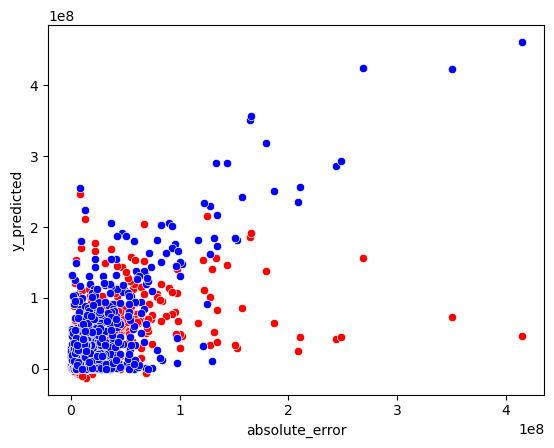

In [182]:
sns.scatterplot(data=data_with_res, x='absolute_error', y='y_predicted', color='red')
sns.scatterplot(data=data_with_res, x='absolute_error', y='y_true', color='blue')
plt.show()

In [183]:
indexes = []
for index in gross_column.index:
    if index in budget_column.index and index in is_USA_column.index and index in is_genre_columns.index:
        indexes.append(index)
t = pd.concat([gross_column.loc[indexes], budget_column.loc[indexes], is_USA_column.loc[indexes], is_genre_columns.loc[indexes]], axis=1)
t = t.dropna()
y = t['gross'].to_frame()
X = t.drop(columns='gross')
X_train_val, X_test, y_train_val, y_test = train_test_split(X, y, test_size=0.2, random_state=2)
indexes = X_train_val.index
X_scaler = MinMaxScaler()
y_scaler = MinMaxScaler()
X_train_val = X_scaler.fit_transform(X_train_val)
y_train_val = y_scaler.fit_transform(y_train_val)
y_train_val = np.array(y_train_val).reshape((-1))

In [184]:
folds = 5
kf = KFold(n_splits=folds, shuffle=True, random_state=1)
n_iterations = 100
for train_index, val_index in kf.split(X_train_val):
    model = SGDRegressor(learning_rate='constant', early_stopping=False, max_iter=1000000, eta0=0.001)
    for i in range(n_iterations):
        model.partial_fit(X_train_val[train_index], y_train_val[train_index])
    y_pred = model.predict(X_train_val[val_index])
    score = mean_squared_error(y_train_val[val_index], y_pred)
    print(f"Score on fold = {score}")
    break
y_pred = y_scaler.inverse_transform(y_pred.reshape((-1, 1)))
y_train_val = y_scaler.inverse_transform(y_train_val[val_index].reshape((-1, 1)))
original_indexes = indexes[val_index]
data_with_res = data.loc[original_indexes]
data_with_res['y_predicted'] = 3
data_with_res['y_true'] = 3
data_with_res['per_error'] = 3
for i in range(len(original_indexes)):
    t = y_pred[i].item()
    data_with_res.loc[original_indexes[i], 'y_predicted'] = int(t)
    t = y_train_val[i].item()
    data_with_res.loc[original_indexes[i], 'y_true'] = int(t)
    t = (abs(y_pred[i] - y_train_val[i]) / y_train_val[i]).item()
    data_with_res.loc[original_indexes[i], 'per_error'] = int(t)
data_with_res.sort_values(by='per_error', ascending=False)

Score on fold = 0.005979883010748233


,movie_title,director_name,num_critic_for_reviews,duration,director_facebook_likes,actor_3_facebook_likes,actor_2_name,actor_1_facebook_likes,gross,genres,actor_1_name,color,num_voted_users,cast_total_facebook_likes,actor_3_name,facenumber_in_poster,plot_keywords,movie_imdb_link,num_user_for_reviews,language,country,content_rating,budget,title_year,actor_2_facebook_likes,imdb_score,aspect_ratio,movie_facebook_likes,Unnamed: 28,war_symb_title,point_symb_title,is_series,y_predicted,y_true,per_error
1527,Thunder and the House of Magic,Jeremy Degruson,60.0,85.0,0.0,11.0,Brianne Brozey,324.0,4091.0,Adventure|Animation|Comedy|Family|Fantasy,Kyle Hebert,Color,4265,369,Joe Ochman,0,NaN,http://www.imdb.com/title/tt3148834/?ref_=fn_t...,16,English,Belgium,NaN,34000000.0,2013.0,15.0,6.3,2.35,0,NaN,3,0,False,53642321,4091,13111
4721,The Harvest/La Cosecha,U. Roberto Romano,3.0,80.0,6.0,NaN,NaN,NaN,2245.0,Documentary,NaN,Color,57,0,NaN,0,child labor|education|hispanic|labor|migration,http://www.imdb.com/title/tt1981703/?ref_=fn_t...,2,English,USA,NaN,560000.0,2011.0,NaN,7.2,NaN,88,NaN,4,0,False,16075269,2245,7159
3873,Falcon Rising,Ernie Barbarash,29.0,103.0,249.0,261.0,Michael J. Morris,2000.0,8691.0,Action|Adventure,Michael Jai White,Color,4952,3089,Lateef Crowder,1,NaN,http://www.imdb.com/title/tt2295722/?ref_=fn_t...,32,English,USA,R,4500000.0,2014.0,298.0,5.8,NaN,0,NaN,2,0,False,37067605,8691,4264
4506,The Knife of Don Juan,Tom Sanchez,1.0,110.0,0.0,0.0,Antonio Arrué,3.0,3830.0,Comedy|Drama,Nataniel Sánchez,Color,27,5,Juan Carlos Montoya,3,NaN,http://www.imdb.com/title/tt1349485/?ref_=fn_t...,1,Spanish,USA,NaN,1200000.0,2013.0,2.0,7.2,NaN,75,NaN,1,0,False,13631500,3830,3558
5044,Newlyweds,Edward Burns,14.0,95.0,0.0,133.0,Caitlin FitzGerald,296.0,4584.0,Comedy|Drama,Kerry Bishé,Color,1338,690,Daniella Pineda,1,written and directed by cast member,http://www.imdb.com/title/tt1880418/?ref_=fn_t...,14,English,USA,Not Rated,9000.0,2011.0,205.0,6.4,NaN,413,NaN,2,0,False,12552728,4584,2737
4604,Special,Hal Haberman,56.0,81.0,0.0,394.0,Paul Blackthorne,975.0,6387.0,Comedy|Drama|Sci-Fi,Michael Rapaport,Color,4862,2694,Ian Bohen,0,dream sequence|locked in a room|looking at sel...,http://www.imdb.com/title/tt0479162/?ref_=fn_t...,37,English,USA,R,1000000.0,2006.0,645.0,6.9,1.85,0,NaN,1,0,False,15872069,6387,2484
4841,Fighting Tommy Riley,Eddie O'Flaherty,13.0,109.0,3.0,25.0,Eddie Jones,54.0,5199.0,Drama|Sport,Don Wallace,Color,720,185,Christina Chambers,0,older man younger man relationship|punching ba...,http://www.imdb.com/title/tt0366444/?ref_=fn_t...,23,English,USA,R,200000.0,2004.0,53.0,6.6,2.35,30,NaN,1,0,False,10551290,5199,2028
3422,Dear Wendy,Thomas Vinterberg,100.0,102.0,346.0,488.0,Chris Owen,947.0,23106.0,Comedy|Crime|Drama|Romance,Michael Angarano,Color,9003,2572,William Hootkins,0,gang|gun|loner|love|outcast,http://www.imdb.com/title/tt0342272/?ref_=fn_t...,58,English,Italy,Unrated,50000000.0,2004.0,526.0,6.6,1.66,532,NaN,3,0,False,37285599,23106,1612
4790,As It Is in Heaven,Kay Pollak,34.0,133.0,10.0,19.0,Frida Hallgren,690.0,9910.0,Comedy|Drama|Music|Romance,Michael Nyqvist,Color,13543,774,Nils-Anders Vallgårda,15,amazing grace the hymn|choir|heart attack|home...,http://www.imdb.com/title/tt0382330/?ref_=fn_t...,94,Swedish,Sweden,NaN,25000000.0,2004.0,24.0,7.6,1.85,0,NaN,2,0,False,15854550,9910,1598
4600,The Specials,Craig Mazin,29.0,82.0,82.0,490.0,James Gunn,2000.0,12996.0,Action|Comedy|Fantasy|Sci-Fi,Judy Greer,Color,1938,3905,Jamie Kennedy,0,action figure|press conference|superhero|super...,http://www.imdb.com/title/tt0181836/?ref_=fn_t...,54,English,USA,R,1000000.0,2000.0,571.0,6.0,1.85,210,NaN,1,0,False,20553755,12996,1580


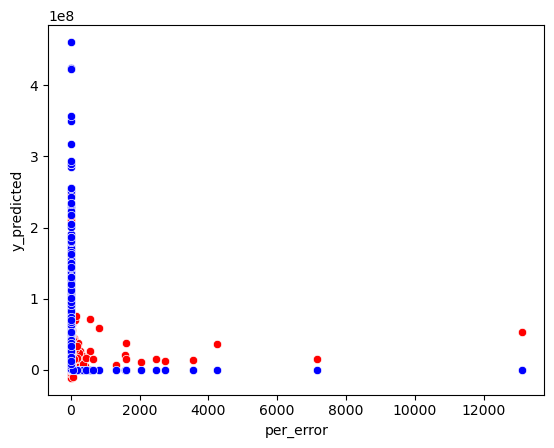

In [185]:
sns.scatterplot(data=data_with_res, x='per_error', y='y_predicted', color='red')
sns.scatterplot(data=data_with_res, x='per_error', y='y_true', color='blue')
plt.show()

In [186]:
indexes = []
for index in gross_column.index:
    if index in budget_column.index and index in is_USA_column.index and index in is_genre_columns.index:
        indexes.append(index)
t = pd.concat([gross_column.loc[indexes], budget_column.loc[indexes], is_USA_column.loc[indexes], is_genre_columns.loc[indexes]], axis=1)
t = t.dropna()
y = t['gross'].to_frame()
X = t.drop(columns='gross')
X_train_val, X_test, y_train_val, y_test = train_test_split(X, y, test_size=0.2, random_state=2)
indexes = X_train_val.index
X_scaler = MinMaxScaler()
y_scaler = MinMaxScaler()
X_train_val = X_scaler.fit_transform(X_train_val)
y_train_val = y_scaler.fit_transform(y_train_val)
y_train_val = np.array(y_train_val).reshape((-1))

In [187]:
folds = 5
kf = KFold(n_splits=folds, shuffle=True, random_state=1)
n_iterations = 100
for train_index, val_index in kf.split(X_train_val):
    model = RandomForestRegressor(n_estimators=40, max_depth=10, min_samples_split=25, min_samples_leaf=3)
    model.fit(X_train_val[train_index], y_train_val[train_index])
    y_pred = model.predict(X_train_val[val_index])
    score = mean_squared_error(y_train_val[val_index], y_pred)
    print(f"Score on fold = {score}")
    break
y_pred = y_scaler.inverse_transform(y_pred.reshape((-1, 1)))
y_train_val = y_scaler.inverse_transform(y_train_val[val_index].reshape((-1, 1)))
original_indexes = indexes[val_index]
data_with_res = data.loc[original_indexes]
data_with_res['y_predicted'] = 3
data_with_res['y_true'] = 3
data_with_res['per_error'] = 3
data_with_res['absolute_error'] = 3
for i in range(len(original_indexes)):
    t = y_pred[i].item()
    data_with_res.loc[original_indexes[i], 'y_predicted'] = int(t)
    t = y_train_val[i].item()
    data_with_res.loc[original_indexes[i], 'y_true'] = int(t)
    t = (abs(y_pred[i] - y_train_val[i]) / y_train_val[i]).item()
    data_with_res.loc[original_indexes[i], 'per_error'] = int(t)
    t = abs(y_pred[i] - y_train_val[i]).item()
    data_with_res.loc[original_indexes[i], 'absolute_error'] = int(t)
data_with_res.sort_values(by='per_error', ascending=False)

Score on fold = 0.005930452075604439


,movie_title,director_name,num_critic_for_reviews,duration,director_facebook_likes,actor_3_facebook_likes,actor_2_name,actor_1_facebook_likes,gross,genres,actor_1_name,color,num_voted_users,cast_total_facebook_likes,actor_3_name,facenumber_in_poster,plot_keywords,movie_imdb_link,num_user_for_reviews,language,country,content_rating,budget,title_year,actor_2_facebook_likes,imdb_score,aspect_ratio,movie_facebook_likes,Unnamed: 28,war_symb_title,point_symb_title,is_series,y_predicted,y_true,per_error,absolute_error
1527,Thunder and the House of Magic,Jeremy Degruson,60.0,85.0,0.0,11.0,Brianne Brozey,324.0,4091.0,Adventure|Animation|Comedy|Family|Fantasy,Kyle Hebert,Color,4265,369,Joe Ochman,0,NaN,http://www.imdb.com/title/tt3148834/?ref_=fn_t...,16,English,Belgium,NaN,34000000.0,2013.0,15.0,6.3,2.35,0,NaN,3,0,False,45706179,4091,11171,45702088
4207,Anatomy,Stefan Ruzowitzky,62.0,103.0,24.0,10.0,Rüdiger Vogler,127.0,5725.0,Horror|Thriller,Benno Fürmann,Color,10220,163,Sebastian Blomberg,0,dissection|male pubic hair|medical school|medi...,http://www.imdb.com/title/tt0187696/?ref_=fn_t...,110,German,Germany,R,8400000.0,2000.0,10.0,6.1,2.35,560,NaN,2,0,False,25922171,5725,4526,25916446
3873,Falcon Rising,Ernie Barbarash,29.0,103.0,249.0,261.0,Michael J. Morris,2000.0,8691.0,Action|Adventure,Michael Jai White,Color,4952,3089,Lateef Crowder,1,NaN,http://www.imdb.com/title/tt2295722/?ref_=fn_t...,32,English,USA,R,4500000.0,2014.0,298.0,5.8,NaN,0,NaN,2,0,False,27622162,8691,3177,27613471
4790,As It Is in Heaven,Kay Pollak,34.0,133.0,10.0,19.0,Frida Hallgren,690.0,9910.0,Comedy|Drama|Music|Romance,Michael Nyqvist,Color,13543,774,Nils-Anders Vallgårda,15,amazing grace the hymn|choir|heart attack|home...,http://www.imdb.com/title/tt0382330/?ref_=fn_t...,94,Swedish,Sweden,NaN,25000000.0,2004.0,24.0,7.6,1.85,0,NaN,2,0,False,23306008,9910,2350,23296098
4841,Fighting Tommy Riley,Eddie O'Flaherty,13.0,109.0,3.0,25.0,Eddie Jones,54.0,5199.0,Drama|Sport,Don Wallace,Color,720,185,Christina Chambers,0,older man younger man relationship|punching ba...,http://www.imdb.com/title/tt0366444/?ref_=fn_t...,23,English,USA,R,200000.0,2004.0,53.0,6.6,2.35,30,NaN,1,0,False,11669526,5199,2243,11664327
3422,Dear Wendy,Thomas Vinterberg,100.0,102.0,346.0,488.0,Chris Owen,947.0,23106.0,Comedy|Crime|Drama|Romance,Michael Angarano,Color,9003,2572,William Hootkins,0,gang|gun|loner|love|outcast,http://www.imdb.com/title/tt0342272/?ref_=fn_t...,58,English,Italy,Unrated,50000000.0,2004.0,526.0,6.6,1.66,532,NaN,3,0,False,44059994,23106,1905,44036888
4815,Maniac,Franck Khalfoun,279.0,89.0,33.0,118.0,Nora Arnezeder,470.0,12843.0,Horror|Thriller,America Olivo,Color,27297,1233,Liane Balaban,0,exhibition|mannequin|obsession|oral sex|photog...,http://www.imdb.com/title/tt2103217/?ref_=fn_t...,131,English,France,Not Rated,6000000.0,2012.0,378.0,6.1,2.35,0,NaN,2,0,False,21111476,12843,1642,21098633
5044,Newlyweds,Edward Burns,14.0,95.0,0.0,133.0,Caitlin FitzGerald,296.0,4584.0,Comedy|Drama,Kerry Bishé,Color,1338,690,Daniella Pineda,1,written and directed by cast member,http://www.imdb.com/title/tt1880418/?ref_=fn_t...,14,English,USA,Not Rated,9000.0,2011.0,205.0,6.4,NaN,413,NaN,2,0,False,7123914,4584,1553,7119330
4506,The Knife of Don Juan,Tom Sanchez,1.0,110.0,0.0,0.0,Antonio Arrué,3.0,3830.0,Comedy|Drama,Nataniel Sánchez,Color,27,5,Juan Carlos Montoya,3,NaN,http://www.imdb.com/title/tt1349485/?ref_=fn_t...,1,Spanish,USA,NaN,1200000.0,2013.0,2.0,7.2,NaN,75,NaN,1,0,False,3459615,3830,902,3455785
3078,The Last Days on Mars,Ruairi Robinson,120.0,98.0,7.0,507.0,Olivia Williams,805.0,23838.0,Horror|Sci-Fi|Thriller,Romola Garai,Color,28570,2271,Tom Cullen,0,alien infection|astronaut|mars|mission|zombie,http://www.imdb.com/title/tt1709143/?ref_=fn_t...,160,English,UK,R,7000000.0,2013.0,766.0,5.5,2.35,0,NaN,4,0,False,21425426,23838,897,21401588


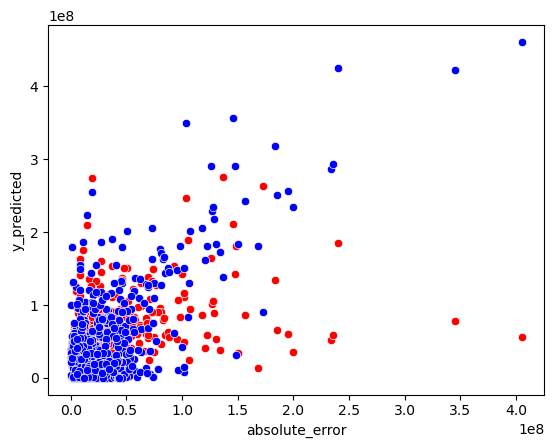

In [188]:
sns.scatterplot(data=data_with_res, x='absolute_error', y='y_predicted', color='red')
sns.scatterplot(data=data_with_res, x='absolute_error', y='y_true', color='blue')
plt.show()

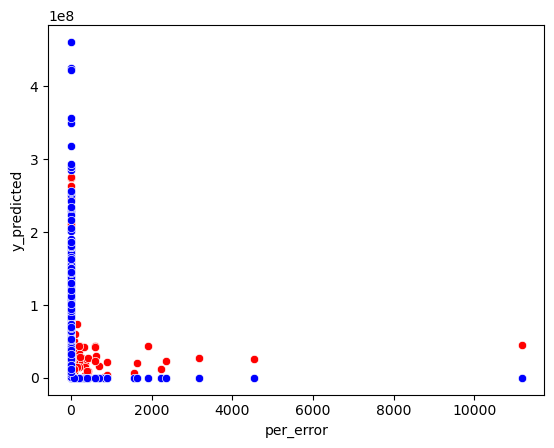

In [189]:
sns.scatterplot(data=data_with_res, x='per_error', y='y_predicted', color='red')
sns.scatterplot(data=data_with_res, x='per_error', y='y_true', color='blue')
plt.show()

In [190]:
indexes = []
for index in gross_column.index:
    if index in budget_column.index and index in is_USA_column.index and index in is_genre_columns.index:
        indexes.append(index)
t = pd.concat([gross_column.loc[indexes], budget_column.loc[indexes], is_USA_column.loc[indexes], is_genre_columns.loc[indexes]], axis=1)
t = t.dropna()
y = t['gross'].to_frame()
X = t.drop(columns='gross')
X_train_val, X_test, y_train_val, y_test = train_test_split(X, y, test_size=0.2, random_state=2)
indexes = X_train_val.index
X_scaler = MinMaxScaler()
y_scaler = MinMaxScaler()
X_train_val = X_scaler.fit_transform(X_train_val)
y_train_val = y_scaler.fit_transform(y_train_val)
y_train_val = np.array(y_train_val).reshape((-1))
folds = 5
kf = KFold(n_splits=folds, shuffle=True, random_state=1)
n_iterations = 100
for train_index, val_index in kf.split(X_train_val):
    model = GradientBoostingRegressor(n_estimators=34, learning_rate=0.1, max_depth=2)
    model.fit(X_train_val[train_index], y_train_val[train_index])
    y_pred = model.predict(X_train_val[val_index])
    score = mean_squared_error(y_train_val[val_index], y_pred)
    print(f"Score on fold = {score}")
    break
y_pred = y_scaler.inverse_transform(y_pred.reshape((-1, 1)))
y_train_val = y_scaler.inverse_transform(y_train_val[val_index].reshape((-1, 1)))
original_indexes = indexes[val_index]
data_with_res = data.loc[original_indexes]
data_with_res['y_predicted'] = 3
data_with_res['y_true'] = 3
data_with_res['per_error'] = 3
data_with_res['absolute_error'] = 3
for i in range(len(original_indexes)):
    t = y_pred[i].item()
    data_with_res.loc[original_indexes[i], 'y_predicted'] = int(t)
    t = y_train_val[i].item()
    data_with_res.loc[original_indexes[i], 'y_true'] = int(t)
    t = (abs(y_pred[i] - y_train_val[i]) / y_train_val[i]).item()
    data_with_res.loc[original_indexes[i], 'per_error'] = int(t)
    t = abs(y_pred[i] - y_train_val[i]).item()
    data_with_res.loc[original_indexes[i], 'absolute_error'] = int(t)
data_with_res.sort_values(by='per_error', ascending=False)

Score on fold = 0.006058845214260699


,movie_title,director_name,num_critic_for_reviews,duration,director_facebook_likes,actor_3_facebook_likes,actor_2_name,actor_1_facebook_likes,gross,genres,actor_1_name,color,num_voted_users,cast_total_facebook_likes,actor_3_name,facenumber_in_poster,plot_keywords,movie_imdb_link,num_user_for_reviews,language,country,content_rating,budget,title_year,actor_2_facebook_likes,imdb_score,aspect_ratio,movie_facebook_likes,Unnamed: 28,war_symb_title,point_symb_title,is_series,y_predicted,y_true,per_error,absolute_error
1527,Thunder and the House of Magic,Jeremy Degruson,60.0,85.0,0.0,11.0,Brianne Brozey,324.0,4091.0,Adventure|Animation|Comedy|Family|Fantasy,Kyle Hebert,Color,4265,369,Joe Ochman,0,NaN,http://www.imdb.com/title/tt3148834/?ref_=fn_t...,16,English,Belgium,NaN,34000000.0,2013.0,15.0,6.3,2.35,0,NaN,3,0,False,40028892,4091,9783,40024801
4721,The Harvest/La Cosecha,U. Roberto Romano,3.0,80.0,6.0,NaN,NaN,NaN,2245.0,Documentary,NaN,Color,57,0,NaN,0,child labor|education|hispanic|labor|migration,http://www.imdb.com/title/tt1981703/?ref_=fn_t...,2,English,USA,NaN,560000.0,2011.0,NaN,7.2,NaN,88,NaN,4,0,False,19367721,2245,8626,19365476
4506,The Knife of Don Juan,Tom Sanchez,1.0,110.0,0.0,0.0,Antonio Arrué,3.0,3830.0,Comedy|Drama,Nataniel Sánchez,Color,27,5,Juan Carlos Montoya,3,NaN,http://www.imdb.com/title/tt1349485/?ref_=fn_t...,1,Spanish,USA,NaN,1200000.0,2013.0,2.0,7.2,NaN,75,NaN,1,0,False,16494108,3830,4305,16490278
3873,Falcon Rising,Ernie Barbarash,29.0,103.0,249.0,261.0,Michael J. Morris,2000.0,8691.0,Action|Adventure,Michael Jai White,Color,4952,3089,Lateef Crowder,1,NaN,http://www.imdb.com/title/tt2295722/?ref_=fn_t...,32,English,USA,R,4500000.0,2014.0,298.0,5.8,NaN,0,NaN,2,0,False,32014681,8691,3682,32005990
5044,Newlyweds,Edward Burns,14.0,95.0,0.0,133.0,Caitlin FitzGerald,296.0,4584.0,Comedy|Drama,Kerry Bishé,Color,1338,690,Daniella Pineda,1,written and directed by cast member,http://www.imdb.com/title/tt1880418/?ref_=fn_t...,14,English,USA,Not Rated,9000.0,2011.0,205.0,6.4,NaN,413,NaN,2,0,False,16494108,4584,3597,16489524
4207,Anatomy,Stefan Ruzowitzky,62.0,103.0,24.0,10.0,Rüdiger Vogler,127.0,5725.0,Horror|Thriller,Benno Fürmann,Color,10220,163,Sebastian Blomberg,0,dissection|male pubic hair|medical school|medi...,http://www.imdb.com/title/tt0187696/?ref_=fn_t...,110,German,Germany,R,8400000.0,2000.0,10.0,6.1,2.35,560,NaN,2,0,False,19001056,5725,3317,18995331
4841,Fighting Tommy Riley,Eddie O'Flaherty,13.0,109.0,3.0,25.0,Eddie Jones,54.0,5199.0,Drama|Sport,Don Wallace,Color,720,185,Christina Chambers,0,older man younger man relationship|punching ba...,http://www.imdb.com/title/tt0366444/?ref_=fn_t...,23,English,USA,R,200000.0,2004.0,53.0,6.6,2.35,30,NaN,1,0,False,16494108,5199,3171,16488909
4604,Special,Hal Haberman,56.0,81.0,0.0,394.0,Paul Blackthorne,975.0,6387.0,Comedy|Drama|Sci-Fi,Michael Rapaport,Color,4862,2694,Ian Bohen,0,dream sequence|locked in a room|looking at sel...,http://www.imdb.com/title/tt0479162/?ref_=fn_t...,37,English,USA,R,1000000.0,2006.0,645.0,6.9,1.85,0,NaN,1,0,False,16494108,6387,2581,16487721
4790,As It Is in Heaven,Kay Pollak,34.0,133.0,10.0,19.0,Frida Hallgren,690.0,9910.0,Comedy|Drama|Music|Romance,Michael Nyqvist,Color,13543,774,Nils-Anders Vallgårda,15,amazing grace the hymn|choir|heart attack|home...,http://www.imdb.com/title/tt0382330/?ref_=fn_t...,94,Swedish,Sweden,NaN,25000000.0,2004.0,24.0,7.6,1.85,0,NaN,2,0,False,24571153,9910,2478,24561243
3422,Dear Wendy,Thomas Vinterberg,100.0,102.0,346.0,488.0,Chris Owen,947.0,23106.0,Comedy|Crime|Drama|Romance,Michael Angarano,Color,9003,2572,William Hootkins,0,gang|gun|loner|love|outcast,http://www.imdb.com/title/tt0342272/?ref_=fn_t...,58,English,Italy,Unrated,50000000.0,2004.0,526.0,6.6,1.66,532,NaN,3,0,False,37116096,23106,1605,37092990


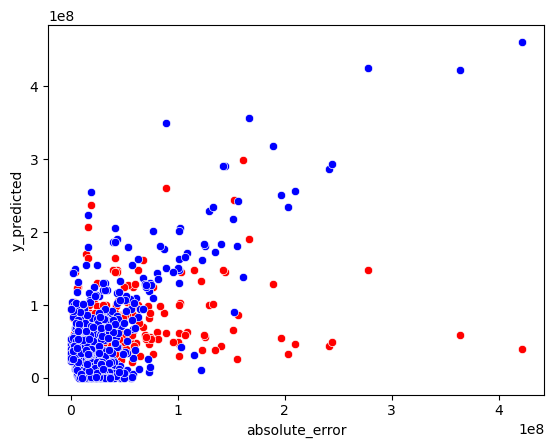

In [191]:
sns.scatterplot(data=data_with_res, x='absolute_error', y='y_predicted', color='red')
sns.scatterplot(data=data_with_res, x='absolute_error', y='y_true', color='blue')
plt.show()

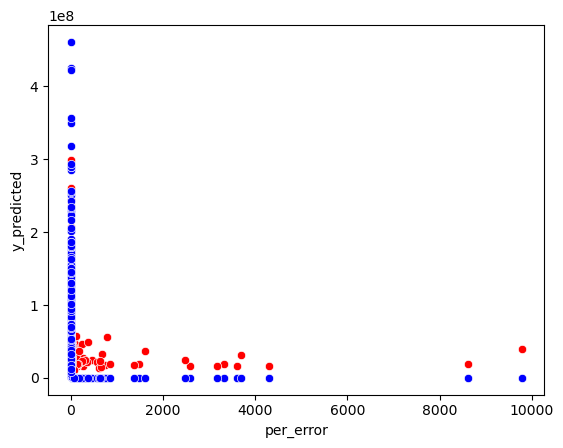

In [192]:
sns.scatterplot(data=data_with_res, x='per_error', y='y_predicted', color='red')
sns.scatterplot(data=data_with_res, x='per_error', y='y_true', color='blue')
plt.show()

In [193]:
indexes = []
for index in gross_column.index:
    if index in budget_column.index and index in is_USA_column.index and index in is_genre_columns.index:
        indexes.append(index)
t = pd.concat([gross_column.loc[indexes], budget_column.loc[indexes], is_USA_column.loc[indexes], is_genre_columns.loc[indexes]], axis=1)
t = t.dropna()
y = t['gross'].to_frame()
X = t.drop(columns='gross')
X_train_val, X_test, y_train_val, y_test = train_test_split(X, y, test_size=0.2, random_state=2)
indexes = X_train_val.index
X_scaler = MinMaxScaler()
y_scaler = MinMaxScaler()
X_train_val = X_scaler.fit_transform(X_train_val)
y_train_val = y_scaler.fit_transform(y_train_val)
y_train_val = np.array(y_train_val).reshape((-1))
folds = 5
kf = KFold(n_splits=folds, shuffle=True, random_state=1)
n_iterations = 100
for train_index, val_index in kf.split(X_train_val):
    model = xgb.XGBRegressor(objective='reg:squarederror', n_estimators=6, max_depth=5, learning_rate=0.35)
    model.fit(X_train_val[train_index], y_train_val[train_index])
    y_pred = model.predict(X_train_val[val_index])
    score = mean_squared_error(y_train_val[val_index], y_pred)
    print(f"Score on fold = {score}")
    break
y_pred = y_scaler.inverse_transform(y_pred.reshape((-1, 1)))
y_train_val = y_scaler.inverse_transform(y_train_val[val_index].reshape((-1, 1)))
original_indexes = indexes[val_index]
data_with_res = data.loc[original_indexes]
data_with_res['y_predicted'] = 3
data_with_res['y_true'] = 3
data_with_res['per_error'] = 3
data_with_res['absolute_error'] = 3
for i in range(len(original_indexes)):
    t = y_pred[i].item()
    data_with_res.loc[original_indexes[i], 'y_predicted'] = int(t)
    t = y_train_val[i].item()
    data_with_res.loc[original_indexes[i], 'y_true'] = int(t)
    t = (abs(y_pred[i] - y_train_val[i]) / y_train_val[i]).item()
    data_with_res.loc[original_indexes[i], 'per_error'] = int(t)
    t = abs(y_pred[i] - y_train_val[i]).item()
    data_with_res.loc[original_indexes[i], 'absolute_error'] = int(t)
data_with_res.sort_values(by='per_error', ascending=False)

Score on fold = 0.006159593162340928


,movie_title,director_name,num_critic_for_reviews,duration,director_facebook_likes,actor_3_facebook_likes,actor_2_name,actor_1_facebook_likes,gross,genres,actor_1_name,color,num_voted_users,cast_total_facebook_likes,actor_3_name,facenumber_in_poster,plot_keywords,movie_imdb_link,num_user_for_reviews,language,country,content_rating,budget,title_year,actor_2_facebook_likes,imdb_score,aspect_ratio,movie_facebook_likes,Unnamed: 28,war_symb_title,point_symb_title,is_series,y_predicted,y_true,per_error,absolute_error
1527,Thunder and the House of Magic,Jeremy Degruson,60.0,85.0,0.0,11.0,Brianne Brozey,324.0,4091.0,Adventure|Animation|Comedy|Family|Fantasy,Kyle Hebert,Color,4265,369,Joe Ochman,0,NaN,http://www.imdb.com/title/tt3148834/?ref_=fn_t...,16,English,Belgium,NaN,34000000.0,2013.0,15.0,6.3,2.35,0,NaN,3,0,False,38063792,4091,9303,38059701
4207,Anatomy,Stefan Ruzowitzky,62.0,103.0,24.0,10.0,Rüdiger Vogler,127.0,5725.0,Horror|Thriller,Benno Fürmann,Color,10220,163,Sebastian Blomberg,0,dissection|male pubic hair|medical school|medi...,http://www.imdb.com/title/tt0187696/?ref_=fn_t...,110,German,Germany,R,8400000.0,2000.0,10.0,6.1,2.35,560,NaN,2,0,False,27712354,5725,4839,27706629
4721,The Harvest/La Cosecha,U. Roberto Romano,3.0,80.0,6.0,NaN,NaN,NaN,2245.0,Documentary,NaN,Color,57,0,NaN,0,child labor|education|hispanic|labor|migration,http://www.imdb.com/title/tt1981703/?ref_=fn_t...,2,English,USA,NaN,560000.0,2011.0,NaN,7.2,NaN,88,NaN,4,0,False,10334766,2245,4602,10332521
3873,Falcon Rising,Ernie Barbarash,29.0,103.0,249.0,261.0,Michael J. Morris,2000.0,8691.0,Action|Adventure,Michael Jai White,Color,4952,3089,Lateef Crowder,1,NaN,http://www.imdb.com/title/tt2295722/?ref_=fn_t...,32,English,USA,R,4500000.0,2014.0,298.0,5.8,NaN,0,NaN,2,0,False,23767232,8691,2733,23758541
4506,The Knife of Don Juan,Tom Sanchez,1.0,110.0,0.0,0.0,Antonio Arrué,3.0,3830.0,Comedy|Drama,Nataniel Sánchez,Color,27,5,Juan Carlos Montoya,3,NaN,http://www.imdb.com/title/tt1349485/?ref_=fn_t...,1,Spanish,USA,NaN,1200000.0,2013.0,2.0,7.2,NaN,75,NaN,1,0,False,9054130,3830,2363,9050300
4790,As It Is in Heaven,Kay Pollak,34.0,133.0,10.0,19.0,Frida Hallgren,690.0,9910.0,Comedy|Drama|Music|Romance,Michael Nyqvist,Color,13543,774,Nils-Anders Vallgårda,15,amazing grace the hymn|choir|heart attack|home...,http://www.imdb.com/title/tt0382330/?ref_=fn_t...,94,Swedish,Sweden,NaN,25000000.0,2004.0,24.0,7.6,1.85,0,NaN,2,0,False,21387210,9910,2157,21377300
3422,Dear Wendy,Thomas Vinterberg,100.0,102.0,346.0,488.0,Chris Owen,947.0,23106.0,Comedy|Crime|Drama|Romance,Michael Angarano,Color,9003,2572,William Hootkins,0,gang|gun|loner|love|outcast,http://www.imdb.com/title/tt0342272/?ref_=fn_t...,58,English,Italy,Unrated,50000000.0,2004.0,526.0,6.6,1.66,532,NaN,3,0,False,47269744,23106,2044,47246638
5044,Newlyweds,Edward Burns,14.0,95.0,0.0,133.0,Caitlin FitzGerald,296.0,4584.0,Comedy|Drama,Kerry Bishé,Color,1338,690,Daniella Pineda,1,written and directed by cast member,http://www.imdb.com/title/tt1880418/?ref_=fn_t...,14,English,USA,Not Rated,9000.0,2011.0,205.0,6.4,NaN,413,NaN,2,0,False,9054130,4584,1974,9049546
4815,Maniac,Franck Khalfoun,279.0,89.0,33.0,118.0,Nora Arnezeder,470.0,12843.0,Horror|Thriller,America Olivo,Color,27297,1233,Liane Balaban,0,exhibition|mannequin|obsession|oral sex|photog...,http://www.imdb.com/title/tt2103217/?ref_=fn_t...,131,English,France,Not Rated,6000000.0,2012.0,378.0,6.1,2.35,0,NaN,2,0,False,24105604,12843,1875,24092761
4841,Fighting Tommy Riley,Eddie O'Flaherty,13.0,109.0,3.0,25.0,Eddie Jones,54.0,5199.0,Drama|Sport,Don Wallace,Color,720,185,Christina Chambers,0,older man younger man relationship|punching ba...,http://www.imdb.com/title/tt0366444/?ref_=fn_t...,23,English,USA,R,200000.0,2004.0,53.0,6.6,2.35,30,NaN,1,0,False,9054130,5199,1740,9048931


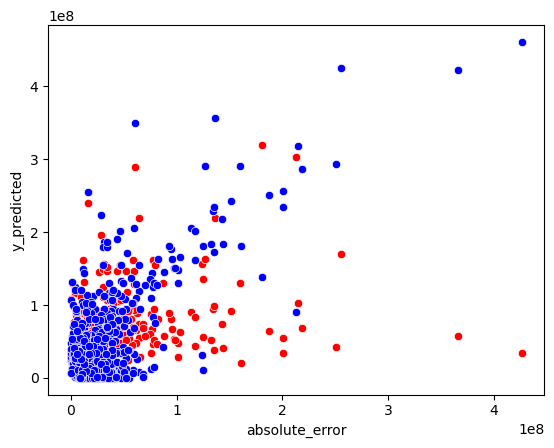

In [194]:
sns.scatterplot(data=data_with_res, x='absolute_error', y='y_predicted', color='red')
sns.scatterplot(data=data_with_res, x='absolute_error', y='y_true', color='blue')
plt.show()

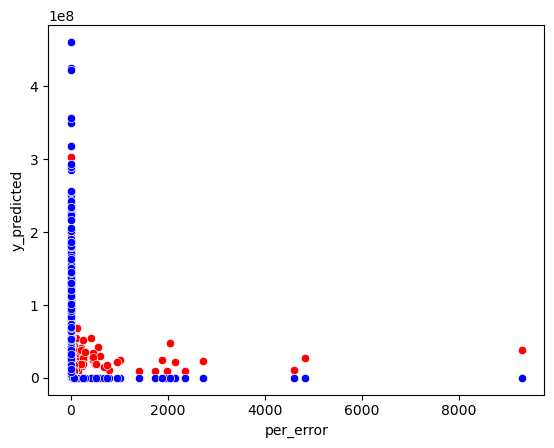

In [195]:
sns.scatterplot(data=data_with_res, x='per_error', y='y_predicted', color='red')
sns.scatterplot(data=data_with_res, x='per_error', y='y_true', color='blue')
plt.show()

In [196]:
indexes = []
for index in gross_column.index:
    if index in budget_column.index and index in is_USA_column.index and index in is_genre_columns.index:
        indexes.append(index)
t = pd.concat([gross_column.loc[indexes], budget_column.loc[indexes], is_USA_column.loc[indexes], is_genre_columns.loc[indexes]], axis=1)
t = t.dropna()
y = t['gross'].to_frame()
X = t.drop(columns='gross')
X_train_val, X_test, y_train_val, y_test = train_test_split(X, y, test_size=0.2, random_state=2)
indexes = X_train_val.index
X_scaler = MinMaxScaler()
y_scaler = MinMaxScaler()
X_train_val = X_scaler.fit_transform(X_train_val)
y_train_val = y_scaler.fit_transform(y_train_val)
y_train_val = np.array(y_train_val).reshape((-1))
folds = 5
kf = KFold(n_splits=folds, shuffle=True, random_state=1)
n_iterations = 100
for train_index, val_index in kf.split(X_train_val):
    model = lgb.LGBMRegressor(objective='regression', metric='rmse', n_estimators=50, max_depth=6)
    model.fit(X_train_val[train_index], y_train_val[train_index])
    y_pred = model.predict(X_train_val[val_index])
    score = mean_squared_error(y_train_val[val_index], y_pred)
    print(f"Score on fold = {score}")
    break
y_pred = y_scaler.inverse_transform(y_pred.reshape((-1, 1)))
y_train_val = y_scaler.inverse_transform(y_train_val[val_index].reshape((-1, 1)))
original_indexes = indexes[val_index]
data_with_res = data.loc[original_indexes]
data_with_res['y_predicted'] = 3
data_with_res['y_true'] = 3
data_with_res['per_error'] = 3
data_with_res['absolute_error'] = 3
for i in range(len(original_indexes)):
    t = y_pred[i].item()
    data_with_res.loc[original_indexes[i], 'y_predicted'] = int(t)
    t = y_train_val[i].item()
    data_with_res.loc[original_indexes[i], 'y_true'] = int(t)
    t = (abs(y_pred[i] - y_train_val[i]) / y_train_val[i]).item()
    data_with_res.loc[original_indexes[i], 'per_error'] = int(t)
    t = abs(y_pred[i] - y_train_val[i]).item()
    data_with_res.loc[original_indexes[i], 'absolute_error'] = int(t)
data_with_res.sort_values(by='per_error', ascending=False)

Score on fold = 0.005908089779540954


,movie_title,director_name,num_critic_for_reviews,duration,director_facebook_likes,actor_3_facebook_likes,actor_2_name,actor_1_facebook_likes,gross,genres,actor_1_name,color,num_voted_users,cast_total_facebook_likes,actor_3_name,facenumber_in_poster,plot_keywords,movie_imdb_link,num_user_for_reviews,language,country,content_rating,budget,title_year,actor_2_facebook_likes,imdb_score,aspect_ratio,movie_facebook_likes,Unnamed: 28,war_symb_title,point_symb_title,is_series,y_predicted,y_true,per_error,absolute_error
1527,Thunder and the House of Magic,Jeremy Degruson,60.0,85.0,0.0,11.0,Brianne Brozey,324.0,4091.0,Adventure|Animation|Comedy|Family|Fantasy,Kyle Hebert,Color,4265,369,Joe Ochman,0,NaN,http://www.imdb.com/title/tt3148834/?ref_=fn_t...,16,English,Belgium,NaN,34000000.0,2013.0,15.0,6.3,2.35,0,NaN,3,0,False,39655147,4091,9692,39651056
4207,Anatomy,Stefan Ruzowitzky,62.0,103.0,24.0,10.0,Rüdiger Vogler,127.0,5725.0,Horror|Thriller,Benno Fürmann,Color,10220,163,Sebastian Blomberg,0,dissection|male pubic hair|medical school|medi...,http://www.imdb.com/title/tt0187696/?ref_=fn_t...,110,German,Germany,R,8400000.0,2000.0,10.0,6.1,2.35,560,NaN,2,0,False,25493028,5725,4451,25487303
4721,The Harvest/La Cosecha,U. Roberto Romano,3.0,80.0,6.0,NaN,NaN,NaN,2245.0,Documentary,NaN,Color,57,0,NaN,0,child labor|education|hispanic|labor|migration,http://www.imdb.com/title/tt1981703/?ref_=fn_t...,2,English,USA,NaN,560000.0,2011.0,NaN,7.2,NaN,88,NaN,4,0,False,8110666,2245,3611,8108421
3873,Falcon Rising,Ernie Barbarash,29.0,103.0,249.0,261.0,Michael J. Morris,2000.0,8691.0,Action|Adventure,Michael Jai White,Color,4952,3089,Lateef Crowder,1,NaN,http://www.imdb.com/title/tt2295722/?ref_=fn_t...,32,English,USA,R,4500000.0,2014.0,298.0,5.8,NaN,0,NaN,2,0,False,26428569,8691,3039,26419878
4790,As It Is in Heaven,Kay Pollak,34.0,133.0,10.0,19.0,Frida Hallgren,690.0,9910.0,Comedy|Drama|Music|Romance,Michael Nyqvist,Color,13543,774,Nils-Anders Vallgårda,15,amazing grace the hymn|choir|heart attack|home...,http://www.imdb.com/title/tt0382330/?ref_=fn_t...,94,Swedish,Sweden,NaN,25000000.0,2004.0,24.0,7.6,1.85,0,NaN,2,0,False,24329486,9910,2454,24319576
3422,Dear Wendy,Thomas Vinterberg,100.0,102.0,346.0,488.0,Chris Owen,947.0,23106.0,Comedy|Crime|Drama|Romance,Michael Angarano,Color,9003,2572,William Hootkins,0,gang|gun|loner|love|outcast,http://www.imdb.com/title/tt0342272/?ref_=fn_t...,58,English,Italy,Unrated,50000000.0,2004.0,526.0,6.6,1.66,532,NaN,3,0,False,48000486,23106,2076,47977380
4815,Maniac,Franck Khalfoun,279.0,89.0,33.0,118.0,Nora Arnezeder,470.0,12843.0,Horror|Thriller,America Olivo,Color,27297,1233,Liane Balaban,0,exhibition|mannequin|obsession|oral sex|photog...,http://www.imdb.com/title/tt2103217/?ref_=fn_t...,131,English,France,Not Rated,6000000.0,2012.0,378.0,6.1,2.35,0,NaN,2,0,False,21343782,12843,1660,21330939
5044,Newlyweds,Edward Burns,14.0,95.0,0.0,133.0,Caitlin FitzGerald,296.0,4584.0,Comedy|Drama,Kerry Bishé,Color,1338,690,Daniella Pineda,1,written and directed by cast member,http://www.imdb.com/title/tt1880418/?ref_=fn_t...,14,English,USA,Not Rated,9000.0,2011.0,205.0,6.4,NaN,413,NaN,2,0,False,6893695,4584,1502,6889111
4506,The Knife of Don Juan,Tom Sanchez,1.0,110.0,0.0,0.0,Antonio Arrué,3.0,3830.0,Comedy|Drama,Nataniel Sánchez,Color,27,5,Juan Carlos Montoya,3,NaN,http://www.imdb.com/title/tt1349485/?ref_=fn_t...,1,Spanish,USA,NaN,1200000.0,2013.0,2.0,7.2,NaN,75,NaN,1,0,False,4353857,3830,1135,4350027
4841,Fighting Tommy Riley,Eddie O'Flaherty,13.0,109.0,3.0,25.0,Eddie Jones,54.0,5199.0,Drama|Sport,Don Wallace,Color,720,185,Christina Chambers,0,older man younger man relationship|punching ba...,http://www.imdb.com/title/tt0366444/?ref_=fn_t...,23,English,USA,R,200000.0,2004.0,53.0,6.6,2.35,30,NaN,1,0,False,5705174,5199,1096,5699975


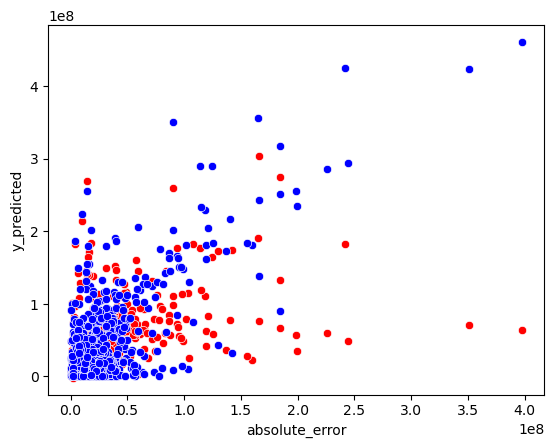

In [197]:
sns.scatterplot(data=data_with_res, x='absolute_error', y='y_predicted', color='red')
sns.scatterplot(data=data_with_res, x='absolute_error', y='y_true', color='blue')
plt.show()

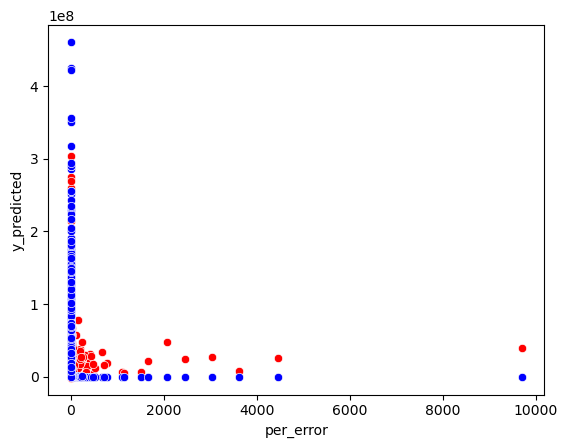

In [198]:
sns.scatterplot(data=data_with_res, x='per_error', y='y_predicted', color='red')
sns.scatterplot(data=data_with_res, x='per_error', y='y_true', color='blue')
plt.show()